In [1]:
%load_ext tensorboard

# CM3070 Final Project

## Machine Learning Model for Domestic Waste Segregation

## Initialization

### Install or upgrade required Python models

Set the `install_libs` variable below to `False` to disable the library install and upgrade.

In [2]:
install_libs = False

import sys

if install_libs is True:
    !{sys.executable} -m pip install --upgrade numpy
    !{sys.executable} -m pip install --upgrade tensorflow[and-cuda]
    !{sys.executable} -m pip install --upgrade matplotlib
    !{sys.executable} -m pip install --upgrade pydot_ng
    !{sys.executable} -m pip install --upgrade graphviz
    !{sys.executable} -m pip install --upgrade pandas
    !{sys.executable} -m pip install --upgrade pyarrow
    !{sys.executable} -m pip install --upgrade tensorboard_plugin_profile
    !{sys.executable} -m pip install --upgrade scikit-learn

### Import required software components

In [3]:
import os
import json
from enum import Enum
import types
import dataclasses
import pathlib
import hashlib
import random
import shutil
import math
from datetime import datetime
import itertools

import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

import IPython

2024-03-11 10:39:19.042288: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-11 10:39:19.042347: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-11 10:39:19.043284: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-11 10:39:19.050357: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-03-11 10:39:19.774543: W tensorflow/compiler/tf2

### Verify GPU support

In [4]:
print("TensorFlow version: ", tf.__version__)
device_name = tf.test.gpu_device_name()
if not device_name:
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

TensorFlow version:  2.15.0
Found GPU at: /device:GPU:0


2024-03-11 10:39:21.300441: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
2024-03-11 10:39:21.301995: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /device:GPU:0 with 18234 MB memory:  -> device: 0, name: NVIDIA RTX 4000 SFF Ada Generation, pci bus id: 0000:07:00.0, compute capability: 8.9


### Define original dataset recategorization rules

- Country-specific category remapping (waste material to country-specific garbage bin type)
- This required adjusting the dataset for the aims of the project, as no perfectly matching dataset is available
- The countries represented with the unique numeric value assigned to the country (simple integer)

In [5]:
COUNTRY_CODE2ID_MAP = { 'NLD': 0, 'HUN': 1 }

CLASS_NAME_REMAPPING = {
    'battery': { 'NLD': 'Battery', 'HUN': 'Akkumlator' },
    'biological': { 'NLD': 'GFT', 'HUN': 'Komposzt' },
    'brown-glass': { 'NLD': 'Glass', 'HUN': 'Szines Uveg' },
    'cardboard': { 'NLD': 'Paper', 'HUN': 'Papir' },
    'clothes': { 'NLD': 'Textil', 'HUN': 'Hulladek' },
    'green-glass': { 'NLD': 'Glass', 'HUN': 'Szines Uveg' },
    'metal': { 'NLD': 'PMD', 'HUN': 'Hulladek' },
    'paper': { 'NLD': 'Paper', 'HUN': 'Papir' },
    'plastic': { 'NLD': 'PMD', 'HUN': 'Muanyag' },
    'shoes': { 'NLD': 'Textil', 'HUN': 'Hulladek' },
    'trash': { 'NLD': 'Garbage', 'HUN': 'Hulladek' },
    'white-glass': { 'NLD': 'Glass', 'HUN': 'Feher Uveg' }
}

### Data profiles

#### Data profile class definitions

The following classes are used to describe the data profiles. This Jupyter notebook can be executed with different data profiles for testing.

In [6]:
@dataclasses.dataclass(frozen = True)
class DatasetSlice:
    name: str
    percent: int

    def __post_init__(self):
        if self.name is None or len(self.name.strip()) == 0:
            raise ValueError('Dataset slice name can not be empty')
        object.__setattr__(self, 'name', self.name.strip())
        if self.percent is None or self.percent < 1 or self.percent > 99:
            raise ValueError('Dataset slice percent must be between 1 and 99')

@dataclasses.dataclass(frozen = True, kw_only = True)
class DataProfile:
    name: str
    data_folder_root: str
    orig_dataset_loc: str
    reinitalize_datasets: bool = False
    orig_dataset_use_precentage: int = None
    unique_images_per_country: bool = False
    image_size: tuple[int] = (192, 192)
    validation_ds_percentage: int = 20
    test_ds_percentage: int = 20
    training_ds_augmentation_rounds: int = 1
    stored_dataset_compression: str = 'GZIP'
    allowed_countries: set = None
    rnd_seed: int = None

    data_folder: str = dataclasses.field(init = False)
    tb_log_loc: str = dataclasses.field(init = False)
    dataset_slices: DatasetSlice = dataclasses.field(init = False)
    # Helper dataset for storing the label to class name mapping for the divided and initialized datasets
    class_names_loc: str = dataclasses.field(init = False)
    preprocessed_datasets_loc: dict[str,str] = dataclasses.field(init = False)
    # Folder for generating the model image
    model_img_loc: str = dataclasses.field(init = False)
    
    def __post_init__(self):
        if self.name is None or len(self.name) == 0:
            raise ValueError('Invalid name')
        object.__setattr__(self, 'data_folder_root', pathlib.Path(self.data_folder_root).resolve())
        if self.data_folder_root == self.data_folder_root.root:
            raise ValueError('Invalid data_folder_root')
        object.__setattr__(self, 'orig_dataset_loc', pathlib.Path(self.orig_dataset_loc))
        if self.orig_dataset_loc.is_absolute() is False:
            object.__setattr__(self, 'orig_dataset_loc', self.data_folder_root.joinpath(self.orig_dataset_loc))
        if self.orig_dataset_use_precentage is not None:
            if self.orig_dataset_use_precentage < 1 or self.orig_dataset_use_precentage > 100:
                raise ValueError('Invalid orig_dataset_use_precentage')
            if self.orig_dataset_use_precentage == 100:
                object.__setattr__(self, 'orig_dataset_use_precentage', None)
        if self.validation_ds_percentage is None or self.validation_ds_percentage < 1 or self.validation_ds_percentage > 99:
            raise ValueError('Invalid validation_ds_percentage')
        if self.test_ds_percentage is None or self.test_ds_percentage < 1 or self.test_ds_percentage > 99:
            raise ValueError('Invalid test_ds_percentage')
        if self.validation_ds_percentage + self.test_ds_percentage  > 99:
            raise ValueError('Invalid validation_ds_percentage and test_ds_percentage combination')
        if self.training_ds_augmentation_rounds is None or self.training_ds_augmentation_rounds < 0 or self.training_ds_augmentation_rounds > 5:
            raise ValueError('Invalid training_ds_augmentation_rounds [0;5]')
        if self.stored_dataset_compression is not None and self.stored_dataset_compression not in [ 'GZIP' ]:
            raise ValueError('Unsupported dataset compression')
        if self.allowed_countries is not None and len(self.allowed_countries) == 0:
            object.__setattr__(self, 'allowed_countries', None)
            

        object.__setattr__(self, 'data_folder', self.data_folder_root.joinpath('data', self.name))
        object.__setattr__(self, 'tb_log_loc', self.data_folder.joinpath('tb_log'))
        object.__setattr__(self, 'dataset_slices', ( 
            DatasetSlice('training', 100 - (self.test_ds_percentage + self.validation_ds_percentage)),
            DatasetSlice('validation', self.validation_ds_percentage),
            DatasetSlice('test', self.test_ds_percentage)
        ))
        object.__setattr__(self, 'class_names_loc', self.data_folder.joinpath('class_names.json'))
        
        preprocessed_ds_names = [ ds_slice.name for ds_slice in self.dataset_slices ]
        preprocessed_ds_names.append('augmented_training')
        preprocessed_datasets_loc = {}
        for preprocessed_ds_name in preprocessed_ds_names:
            preprocessed_datasets_loc[preprocessed_ds_name] = self.data_folder.joinpath('%s_ds' %preprocessed_ds_name)    
        object.__setattr__(self, 'preprocessed_datasets_loc', preprocessed_datasets_loc)
        
        object.__setattr__(self, 'model_img_loc', self.data_folder.joinpath('model_img'))
    
    @staticmethod
    def attributes():
        return set([ f.name for f in dataclasses.fields(DataProfile) if f.init is True ])
        
    def settings(self, cls, sfun = lambda v: v):
        return { k: sfun(v) for k, v in dataclasses.asdict(self).items() if k in cls.attributes() }
        

    def allowed_country_code2id_map(self, country_code2id_map):
        return country_code2id_map if self.allowed_countries is None \
            else { country_code: country_code2id_map[country_code] for country_code in self.allowed_countries }
        

#### Supported data profile definitions

In [7]:
DATA_FOLDER = '/srv/jupyter/zsalab/jupyterlab/data/CM3070-FP'

data_prof_complete = DataProfile(
    name = 'complete',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = None, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = False, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (192, 192),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 10,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 3, # the training dataset will extend to 3 times of the original size
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = None, # set('NLD')
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)

data_prof_mid_size = DataProfile(
    name = 'midsize',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = 50, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = False, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (192, 192),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 10,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 1, # the training dataset will extend to 2 times of the original size
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = None, # set('NLD')
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)

data_prof_min_size = DataProfile(
    name = 'minsize',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = 10, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = False, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (128, 128),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 20,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 0, # the training dataset will not extend
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = None, # set('NLD')
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)

data_prof_complete_unique_images = DataProfile(
    name = 'complete_unique_images',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = None, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = True, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (192, 192),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 10,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 3, # the training dataset will extend to 3 times of the original size
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = None, # set('NLD')
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)


data_prof_nl_only_comp128 = DataProfile(
    name = 'nl-only-comp128',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = None, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = False, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (128, 128),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 10,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 2, # the training dataset will extend to 3 times of the original size
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = set(['NLD']),
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)

data_prof_comp160 = DataProfile(
    name = 'comp160',
    data_folder_root = DATA_FOLDER,
    # The original dataset location
    orig_dataset_loc = 'dataset.orig/garbage_classification_enhanced',
    # Divide and preprocess work [train+validation] and test datasets even if they already exist
    reinitalize_datasets = False,
    # Restrict the number of samples used from the original dataset
    orig_dataset_use_precentage = None, # Set to None to load the full dataset
    # Use the same images for multiple countries
    unique_images_per_country = False, # Set to true to prevent the reuse of images for multiple countries 
    # Resize input images to the given width and height
    image_size = (160, 160),
    # Percentage of the dataset to preserve for testing (used only for split and initialize work [train+validation] and test datasets)
    test_ds_percentage = 10,
    # Percentage of the validation dataset size (the percentage of work dataset used for validation - not related to the original dataset)
    validation_ds_percentage = 20,
    # Multiple the training DS with random transformed images
    training_ds_augmentation_rounds = 2, # the training dataset will extend to 3 times of the original size
    # Limit the supported countries, set of country codes. None means all country allowed
    allowed_countries = None, #set(['NLD']),
    # Set the seed value for randomization
    rnd_seed = 42 # Randon integer used if this variable is set to None
)

#### Selecting the active data profile

In [8]:
active_data_profile =  data_prof_complete
# active_data_profile =  data_prof_min_size
# active_data_profile =  data_prof_comp160
# active_data_profile =  data_prof_mid_size
# active_data_profile =  data_prof_complete_unique_images

#### Initialize active data profile

In [9]:
print('Active data profile name: %s' %active_data_profile.name)

active_data_profile.data_folder.mkdir(parents = True, exist_ok = True)
active_data_profile.model_img_loc.mkdir(parents = True, exist_ok = True)
if active_data_profile.tb_log_loc.exists() is True:
    shutil.rmtree(active_data_profile.tb_log_loc)

if active_data_profile.rnd_seed is not None:
    tf.keras.utils.set_random_seed(active_data_profile.rnd_seed)
#    tf.config.experimental.enable_op_determinism()

Active data profile name: complete


### Enable dataset reinitialization if needed

Enables the (re)initialization of the recategorized datasets if;
- The active data profile settings have changed since the last run.
- The class remapping settings have changed since the last run.
- Any of the required data folder or file is missing.
- The active data profile configured with reinitalize_datasets 

In [10]:
def verify_stored_settings(data_folder, name, settings, hash_function = hashlib.sha512):
    settings_json = json.dumps(settings, sort_keys = True).encode('utf-8')
    settings_hash = hash_function(settings_json).hexdigest()
    settings_loc = data_folder.joinpath('%s.json' %name)
    
    stored_settings_hash = ''
    if settings_loc.exists():
        with settings_loc.open('rb') as f:
            stored_settings_hash = hash_function(f.read()).hexdigest()
    
    changed = settings_hash != stored_settings_hash
    if changed:
        with settings_loc.open('wb') as f:
            f.write(settings_json)

    return changed
    

changed_data_profile_base_settings = verify_stored_settings(
    active_data_profile.data_folder, 
    'data_profile_settings', 
    active_data_profile.settings(DataProfile, str))

changed_category_mapping_settings = verify_stored_settings(
    active_data_profile.data_folder, 
    'category_mapping_settings', { 'country_code2id_map': COUNTRY_CODE2ID_MAP, 'class_name_remapping': CLASS_NAME_REMAPPING })

missing_ds_slice = False
for ds_slice in active_data_profile.dataset_slices:
    if active_data_profile.preprocessed_datasets_loc[ds_slice.name].exists() is False:
        missing_ds_slice = True
        break

missing_augmented_training_ds = (active_data_profile.training_ds_augmentation_rounds > 0) and (active_data_profile.preprocessed_datasets_loc['augmented_training'].exists() is False)

# Enable dataset reinitialization if requested or if any initialized dataset is missing
initalize_datasets = changed_data_profile_base_settings is True \
    or changed_category_mapping_settings is True \
    or active_data_profile.reinitalize_datasets is True \
    or active_data_profile.class_names_loc.exists() is False \
    or missing_ds_slice is True \
    or missing_augmented_training_ds is True
 
print('Dataset initialization is %s' %('ENABLED' if initalize_datasets else 'DISABLED'))

Dataset initialization is DISABLED


### Helper functions for preprocessing the dataset

In [11]:
def get_class_name_label_map(class_names):
    if isinstance(class_names, (list, tuple)) is False:
        raise ValueError('Input class names must be ordered data structure (List or Tuple)')
    class_name_label_map = {}
    for class_label, class_name in enumerate(class_names):
        class_name_label_map[class_name] = class_label
    return class_name_label_map

def get_new_class_label_mapping(orig_class_names, country_code2id_map, class_name_remapping):
    print('Class name remapping:')

    next_new_class_label = 0
    new_class_name_label_map = {}
    orig_class_name_label_map = get_class_name_label_map(orig_class_names)
    
    orig2new_class_label_map_by_country = {}
    orig2new_class_name_map_by_country = {}
    
    for country_code in sorted(country_code2id_map.keys()):
        country_id = country_code2id_map[country_code]
        for orig_class_name in sorted(class_name_remapping.keys()):
                orig_class_label = orig_class_name_label_map[orig_class_name]
                new_class_name = '%s (%s)' %(class_name_remapping[orig_class_name][country_code], country_code)

                new_class_label = next_new_class_label
                if new_class_name in new_class_name_label_map:
                    new_class_label = new_class_name_label_map[new_class_name]
                else:
                    new_class_name_label_map[new_class_name] = new_class_label
                    next_new_class_label += 1 
                
                if country_id not in orig2new_class_label_map_by_country:
                    orig2new_class_label_map_by_country[country_id] = {}
                orig2new_class_label_map_by_country[country_id][orig_class_label] = new_class_label

                if orig_class_name not in orig2new_class_name_map_by_country:
                    orig2new_class_name_map_by_country[orig_class_name] = {}
                orig2new_class_name_map_by_country[orig_class_name][country_code] = new_class_name

    for orig_class_name in sorted(orig2new_class_name_map_by_country.keys()):
        print('    %s [label: %d]' %(orig_class_name, orig_class_name_label_map[orig_class_name]))
        for country_code in sorted(orig2new_class_name_map_by_country[orig_class_name].keys()):
            new_class_name = orig2new_class_name_map_by_country[orig_class_name][country_code]
            print('        %s [label: %d]' %(new_class_name, new_class_name_label_map[new_class_name]))

    new_class_names = [ None ] * len(new_class_name_label_map)
    for new_class_name in new_class_name_label_map:
        new_class_label = new_class_name_label_map[new_class_name]
        new_class_names[new_class_label] = new_class_name

    class_label_mappers = {}
    for country_id in orig2new_class_label_map_by_country:
        orig_class_labels = []
        new_class_labels = []
        for orig_class_label in orig2new_class_label_map_by_country[country_id]:
            orig_class_labels.append(orig_class_label)
            new_class_label = orig2new_class_label_map_by_country[country_id][orig_class_label]
            new_class_labels.append(new_class_label)
        
        class_label_mappers[country_id] = tf.lookup.StaticHashTable(
            tf.lookup.KeyValueTensorInitializer(
                tf.constant(orig_class_labels, dtype = tf.int32), 
                tf.constant(new_class_labels, dtype = tf.int32), key_dtype = tf.int32, value_dtype = tf.int32), 
            default_value = tf.constant(-1, dtype = tf.int32), name = 'class_remapping')

    return (new_class_names, class_label_mappers)

def display_dataset_samples(dataset, class_names, sample_count_per_class = None):
    class_count = len(class_names)
    if sample_count_per_class is None:
        sample_count_per_class = 1
    reaming_class_labels_map = {}
    samples_by_class_label_map = {}
    for class_label in range(class_count):
        reaming_class_labels_map[class_label] = sample_count_per_class
        samples_by_class_label_map[class_label] = []

    for sample in dataset.as_numpy_iterator():
        class_label = sample[-1]
        if class_label in reaming_class_labels_map:
            # Support the original and the recategorized datasets 
            image = sample[0][0] if isinstance(sample[0], tuple) else sample[0]
            samples_by_class_label_map[class_label].append(image)
            reaming_class_labels_map[class_label] -= 1
            if reaming_class_labels_map[class_label] == 0:
                reaming_class_labels_map.pop(class_label)
            if len(reaming_class_labels_map) == 0:
                break

    samples = []
    class_name_label_map = get_class_name_label_map(class_names)
    for class_name in sorted(class_names):
        class_label = class_name_label_map[class_name]
        for image in samples_by_class_label_map[class_label]:
            samples.append((image, class_name))

    display_samples(samples, '%s dataset samples' %dataset.name)

def display_samples(samples, title = None, subplot_cols = 4):
    sample_count = len(samples)
    if sample_count == 0:
        return
    while sample_count < subplot_cols:
        samples.append((np.full((100, 100, 3), fill_value = 224), ''))
        sample_count += 1
    subplot_rows = math.ceil(sample_count / subplot_cols)
    plt.figure(figsize = (3 * subplot_cols, 3 * subplot_rows), constrained_layout = True)
    if title is not None:
        plt.suptitle(title, fontsize = 14)
    subplot_idx = 1
    for image, class_name in samples:
        plt.subplot(subplot_rows, subplot_cols, subplot_idx, facecolor = 'blue')
        plt.imshow(image.astype('uint8'))
        if isinstance(class_name, tuple):
            plt.title(class_name[1], color = 'green', loc = 'right', fontsize = 10)
            plt.text(0.0, -5.5, class_name[0], in_layout = False, color = 'red', ha = 'left', fontsize = 10)
        else:
            plt.title(class_name, fontsize = 10)
        plt.axis('image')
        subplot_idx += 1

    plt.show()


def dataset_class_label_cardinality(dataset):
    labels = list(dataset.map(lambda *tensors: tensors[-1], num_parallel_calls = tf.data.AUTOTUNE).as_numpy_iterator())    
    return np.unique(labels, return_counts = True)

def dataset_class_item_distribution(dataset, class_count):
    dataset_size = dataset.cardinality()
    dataset_class_labels, dataset_class_labels_cardinality = dataset_class_label_cardinality(dataset)
    if dataset_size < 0:
        dataset_size = np.sum(dataset_class_labels_cardinality)
    dataset_class_count = len(dataset_class_labels)
    if class_count < dataset_class_count:
        raise ValueError('The dataset contains more lables then thre given classes')
    stat_cardinality = np.zeros((class_count), dtype = np.int32)
    stat_percent = np.zeros((class_count))
    for i in range(dataset_class_count):
        dataset_class_label = dataset_class_labels[i]
        dataset_class_cardinality = dataset_class_labels_cardinality[i]
        stat_cardinality[dataset_class_label] = dataset_class_cardinality
        dataset_class_percentage = dataset_class_cardinality / dataset_size * 100
        stat_percent[dataset_class_label] = dataset_class_percentage
    return (stat_cardinality, stat_percent)
    
def cross_datasets_class_item_distribution(ds_stats, class_count):
    dataset_count = len(ds_stats)
    cross_ds_stat_cardinality = np.zeros((class_count, dataset_count))
    cross_ds_stat_percent = np.zeros((class_count, dataset_count))
    for ds_idx in range(dataset_count):
        ds_stat = ds_stats[ds_idx][2]
        for class_label in range(class_count):
            cross_ds_stat_cardinality[class_label][ds_idx] = ds_stat[0][class_label]
            cross_ds_stat_percent[class_label][ds_idx] = ds_stat[1][class_label]

    return (cross_ds_stat_cardinality, cross_ds_stat_percent)

def datasets_class_item_distribution(class_names: list[str], datasets: list[tf.data.Dataset]):
    class_count = len(class_names)
    ds_stats = []
    for ds_slice in datasets:
        ds_stats.append(
            ( ds_slice.name, ds_slice.cardinality().numpy(), dataset_class_item_distribution(ds_slice, class_count) )
        )
    cross_ds_stat = cross_datasets_class_item_distribution(ds_stats, class_count)
    return cross_ds_stat, ds_stats

def verify_datasets_class_item_distribution(class_names, cross_ds_stat, ds_stats, allowed_difference_percent):
    valid = True
    violations = []
    class_count = len(class_names)
    dataset_count = len(ds_stats)
    for ds_idx in range(dataset_count):
        ds_name, _, ds_stat = ds_stats[ds_idx]
        if np.min(ds_stat[0]) == 0:
             dataset_missing_classes = [ class_names[class_label] for class_label in np.where(ds_stat[0] == 0)[0] ]
             violations.append('Not all classes represented in dataset %s (missing: %s)' %(ds_name, ', '.join(dataset_missing_classes)))
             valid = False

    unbalanced_class_names = []
    allowed_difference = allowed_difference_percent / 100
    for class_label in range(class_count):
        cl_min = np.min(cross_ds_stat[1][class_label])
        cl_max = np.max(cross_ds_stat[1][class_label])
        diff_ratio = cl_min / cl_max
        # print('Datasets sample ratio for %s label is %.2f < %.2f (min: %.2f, max: %.2f)' %(class_names[class_label], diff_ratio, minimum_class_distribution_difference, cl_min, cl_max))
        if diff_ratio < allowed_difference:
            unbalanced_class_names.append(class_names[class_label])

    if len(unbalanced_class_names) > 0:
        violations.append('Unbalanced distribution for the %s class(es)' %(', '.join(unbalanced_class_names)))
        valid = False

    return valid, violations

def display_dataset_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage):
    table = []
    dataset_count = len(ds_stats)
    sorted_class_names = sorted(class_names)
    class_name_label_map = get_class_name_label_map(class_names)
    for ds_idx in range(dataset_count):
        ds_name, _, ds_stat = ds_stats[ds_idx]
        row = [ ds_name ]
        if percentage is True:
            row.extend([ '%.3f%%' %cross_ds_stat[1][class_name_label_map[class_name]][ds_idx] for class_name in sorted_class_names ])
        else:
            row.extend([ '%d' %cross_ds_stat[0][class_name_label_map[class_name]][ds_idx] for class_name in sorted_class_names ])
        table.append(row)

    if percentage is True:
        print('Class distribution percentage in the datasets')
    else:
        print('Class distribution in the datasets')
    columns = [ 'DataSet' ]
    columns.extend(sorted_class_names)
    pd.options.display.max_columns = None
    df = pd.DataFrame(table, columns = columns)
    IPython.display.display(IPython.display.HTML(df.to_html(index = False)))    

def plot_datasets_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = True):
    xa = np.arange(len(class_names)) 
    di = 1 if percentage is True else 0
    dataset_count = len(ds_stats)
    sorted_class_names = sorted(class_names)
    class_name_label_map = get_class_name_label_map(class_names)
    for ds_idx in range(dataset_count):
        ds_name, _, ds_stat = ds_stats[ds_idx]
        plt.bar(xa + (0.2 * ds_idx), [ cross_ds_stat[di][class_name_label_map[class_name]][ds_idx] for class_name in sorted_class_names ], 0.4, label = ds_name)

    plt.xticks(xa, sorted_class_names, rotation = 90) 
    plt.xlabel("Classes") 
 
    if percentage is True:
        plt.ylabel("Percentage") 
        plt.title('Class distribution percentage in the datasets')
    else:
        plt.ylabel("Number") 
        plt.title('Class distribution in the datasets')

    plt.legend() 
    plt.show()

def fix_dataset_cardinality(dataset, cardinality):
    assert dataset.cardinality() < 0
    dataset._expected_size = tf.constant(cardinality, dtype = tf.int64)
    dataset.cardinality = types.MethodType(lambda  self: self._expected_size, dataset)

def slice_dataset(source_ds, class_names, slices_percent):
    if isinstance(slices_percent, DatasetSlice):
        slices_percent = (slices_percent,)

    if isinstance(slices_percent, tuple) is False or len(slices_percent) < 1:
        raise ValueError('The slices argument expected type is tuple of DatasetSlice with at least one element')
    if sum([ slice.percent for slice in slices_percent ]) > 100:
        raise ValueError('The sum of the size of the slices must be less or equale to 100 (percent)')

    class_count = len(class_names)
    slice_count = len(slices_percent)
    
    source_ds_class_cardinality, source_ds_class_percemtage = dataset_class_item_distribution(source_ds, class_count)
    source_ds_size = np.sum(source_ds_class_cardinality)
    
    slices_def_txt = [ None ] * slice_count
    slices_expected_size = [ None ] * slice_count
    slices_expected_class_size = [ None ] * slice_count
    
    for slice_idx in range(slice_count):
        slice = slices_percent[slice_idx]
        slices_expected_class_size[slice_idx] = [ int(math.floor(source_ds_class_cardinality[class_label] * (slice.percent / 100))) for class_label in range(class_count) ]
        slices_expected_size[slice_idx] = np.sum(slices_expected_class_size[slice_idx])
        slices_def_txt[slice_idx] = '%s: %d%% (%d)' %(slice.name, slice.percent, slices_expected_size[slice_idx])
    slices_def_txt = ', '.join(slices_def_txt)

    print('Slicing the %s (%d) dataset to %s parts' %(source_ds.name, source_ds_size, slices_def_txt))
 
    slices_ds = [ None ] * slice_count
    for class_label in range(class_count):
        source_ds_class_size = source_ds_class_cardinality[class_label]
        source_class_ds = source_ds.filter(lambda x, y: y == class_label)
        if source_class_ds.cardinality() < 0:
            fix_dataset_cardinality(source_class_ds, source_ds_class_size)
        skip = 0
        for slice_idx in range(slice_count):
            slice = slices_percent[slice_idx]
            class_slice_size = slices_expected_class_size[slice_idx][class_label]
            class_slice_ds = (source_class_ds.skip(skip) if skip > 0 else source_class_ds).take(class_slice_size)
            if class_slice_ds.cardinality() < 0:
                fix_dataset_cardinality(class_slice_ds, class_slice_size)
            skip += class_slice_size
            if slices_ds[slice_idx] is not None:
                slices_ds[slice_idx] = slices_ds[slice_idx].concatenate(class_slice_ds)
                slices_ds[slice_idx].name = slice.name
            else:
                class_slice_ds.name = slice.name
                slices_ds[slice_idx] = class_slice_ds

    ds_stats = [
        ( '%s (input)' %source_ds.name, source_ds_size, (source_ds_class_cardinality, source_ds_class_percemtage) )
    ]
    for slice_idx in range(slice_count):
        slice_ds = slices_ds[slice_idx]
        slice_expected_size = slices_expected_size[slice_idx]
        slice_expected_class_cardinality = slices_expected_class_size[slice_idx]
        if slice_ds.cardinality() < 0:
            fix_dataset_cardinality(slice_ds, slice_expected_size)
        ds_stats.append(
            ( '%s (output)' %slice_ds.name, slice_expected_size, (slice_expected_class_cardinality, [ secc / slice_expected_size * 100 for secc in slice_expected_class_cardinality ]) )
        )
        
    cross_ds_stat = cross_datasets_class_item_distribution(ds_stats, class_count)
    valid, violations = verify_datasets_class_item_distribution(class_names, cross_ds_stat, ds_stats, 95)
    
    if valid is False:
        print('Unbalanced class distribution detected\n    %s' %('\n    '.join(violations)))        
        display_dataset_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = True)
        raise ValueError('Unable to slice balanced the %s dataset to %s parts' %(source_ds.name, slices_def_txt))   

    print('Slicing of %s dataset has completed, balanced class distribution detected' %source_ds.name)
    display_dataset_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = False)
    if slice_count == 1:
        return slices_ds[0]
    return slices_ds

def get_class_weights(class_names, cross_ds_stat):
    class_count = len(class_names)
    class_cardinality = []
    for class_label in range(class_count):
        class_cardinality.append(np.sum(cross_ds_stat[0][class_label]))

    max_weigth_precision = math.pow(10, math.floor(math.log(np.max(class_cardinality), 10)))

    table = []
    class_weights = {}
    sorted_class_names = sorted(class_names)
    class_name_label_map = get_class_name_label_map(class_names)
    for class_name in sorted_class_names:
        class_label = class_name_label_map[class_name]
        class_weights[class_label] = max_weigth_precision / class_cardinality[class_label]
        #print('%s: %.4f [label: %d, size: %d]' %(class_name.ljust(30, ' '), class_weights[class_label], class_label, class_cardinality[class_label]))
        table.append([class_name, class_weights[class_label], class_label, class_cardinality[class_label]])

    columns = [ 'Name', 'Weight', 'Label', 'Cardinality' ]
    pd.options.display.max_columns = None
    df = pd.DataFrame(table, columns = columns)
    IPython.display.display(IPython.display.HTML(df.to_html(index = False)))    

    return class_weights

def image_random_transformer():
    return tf.keras.Sequential([
        tf.keras.layers.RandomContrast(0.2, name = 'image_augmentation_random_contrast'),
        tf.keras.layers.RandomBrightness(0.2, name = 'image_augmentation_random_brightness'),
        tf.keras.layers.RandomZoom((-0.2, 0.2), name = 'image_augmentation_random_zoom'),
        tf.keras.layers.RandomFlip('horizontal_and_vertical', name = 'image_augmentation_random_flip'),
        tf.keras.layers.RandomRotation(0.2, name = 'image_augmentation_random_rotate')])

def take_dataset_samples(dataset, class_names, ranges):
    samples = []
    for range in ranges:
        for sample in dataset.skip(range[0]).take(range[1]).as_numpy_iterator():
            class_label = sample[-1]
            class_name = class_names[class_label]
            image = sample[0][0] if isinstance(sample[0], tuple) else sample[0]
            samples.append((image, class_name))
    return samples
    
def augment_dataset(dataset, class_names, augmentation_rounds):
    img_rnd_tr = image_random_transformer()

    dataset_name = dataset.name
    dataset_size = dataset.cardinality()
    
    sample_ranges = [ (0, 2), (dataset_size - 2, 2) ]
    samples = take_dataset_samples(dataset, class_names, sample_ranges)
    
    transormed_datasets = []
    for i in range(augmentation_rounds):
        transformed_ds = dataset.map(lambda x, y: ((tf.cast(img_rnd_tr(tf.expand_dims(x[0], 0), training = True)[0], dtype = tf.uint8), x[1]), y), 
                          num_parallel_calls = tf.data.AUTOTUNE)
        transformed_ds.name = '%sA%d' %(dataset_name, i)
        if transformed_ds.cardinality() < 0:
            fix_dataset_cardinality(transformed_ds, dataset_size)
        samples += take_dataset_samples(transformed_ds, class_names, sample_ranges)
        transormed_datasets.append(transformed_ds)

    augmented_ds = dataset
    augmented_ds_size = dataset_size
    for i in range(augmentation_rounds):
        augmented_ds = augmented_ds.concatenate(transormed_datasets[i])
        augmented_ds_size += dataset_size

    augmented_ds.name = 'augmented_%s' %dataset_name
    if augmented_ds.cardinality() < 0:
        fix_dataset_cardinality(augmented_ds, augmented_ds_size)

    display_samples(samples, 'Augmentation samples')
    
    return augmented_ds

def load_dataset(ds_name, ds_loc, compression):
    dataset = tf.data.Dataset.load(ds_loc, compression = compression)
    one_hot_depth = tf.constant(max(COUNTRY_CODE2ID_MAP.values()) + 1)
    # prefetch and cache the whole DS
    dataset = dataset\
        .prefetch(buffer_size = tf.data.AUTOTUNE)\
        .cache()
    dataset.name = ds_name
    print('Dataset %s loaded from %s location (size: %d)' %(ds_name, ds_loc, dataset.cardinality().numpy()))
    return dataset

def adjust_writable_locations(name, loc):
    absolute_path = pathlib.Path(rw_loc).absolute()
    print(rw_loc)

def hps(hp):
    keys = list(hp.keys())
    lens = [ range(len(hp[keys[i]])) for i in range(len(keys)) ]
    res = []
    for c in itertools.product(*lens):
        r = {}
        #print(c)
        for kidx, vidx in enumerate(c):
            r[keys[kidx]] = hp[keys[kidx]][vidx]
        #print(r)
        res.append(r)
    return res



### Model configuration and execution class definitions

In [12]:
class FixedKerasTensorBoardCallback(tf.keras.callbacks.TensorBoard):
    stop_existing_profiler = None
    profiler_log_dir = None

    def _validate_kwargs(self, kwargs):
        self.stop_existing_profiler = kwargs.pop('stop_existing_profiler', None)
        profiler_log_dir = kwargs.pop('profiler_log_dir', None)

        if profiler_log_dir is not None:
            if isinstance(profiler_log_dir, os.PathLike):
                profiler_log_dir = os.fspath(profiler_log_dir)            
            self.profiler_log_dir = profiler_log_dir
        
        super()._validate_kwargs(kwargs)
        
    def _start_profiler(self, logdir):
        if (not self._profiler_started) and (self.stop_existing_profiler is True):
            try:
                tf.profiler.experimental.stop(save = True)
            except tf.errors.UnavailableError as e:
                pass
            self.stop_existing_profiler = None

        if (self.profiler_log_dir is None) and (logdir is not None):
            self.profiler_log_dir = logdir
        
        super()._start_profiler(self.profiler_log_dir)

class OneHotCategoryEncoding(tf.keras.layers.Layer):
    def __init__(self, depth, **kwargs):
        if "dtype" not in kwargs:
            kwargs["dtype"] = tf.keras.backend.floatx()
        super().__init__(**kwargs)

        if depth is None or depth < 1:
            raise ValueError('depth must be non zero integer')
        self.depth = depth

    def call(self, inputs):
        return tf.one_hot(inputs, self.depth, dtype = self.dtype)

    def compute_output_shape(self, input_shape):
        input_shape = list(input_shape)
        if not input_shape:
            return tf.TensorShape([self.depth])
        if input_shape[-1] != 1:
            return tf.TensorShape(input_shape + [self.depth])

        return tf.TensorShape(input_shape[:-1] + [self.depth])

    def compute_output_signature(self, input_spec):
        output_shape = self.compute_output_shape(input_spec.shape.as_list())
        return tf.TensorSpec(shape = output_shape, dtype = self.dtype)

    def get_config(self):
        config = {
            "depth": self.depth
        }
        base_config = super().get_config()
        return dict(list(base_config.items()) + list(config.items()))

@dataclasses.dataclass(frozen = True)
class TrainingResult:
    epoch: int
    history: dict[str, list[float]]
    
@dataclasses.dataclass(frozen = True)
class PredictionResult:
    true_labels: list[int]
    predicted_labels: list[int]
    good_prediction_samples: list[tuple]
    wrong_prediction_samples: list[tuple]

class ModelConfig(object):
    def image_preproc_layers(self, input_layer: tf.keras.layers.InputLayer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Rescaling(1./255, name = 'image_rescaling')(input_layer)
        return layers

    def data_preproc_layers(self, input_layer: tf.keras.layers.InputLayer, country_max_id: int) -> tf.keras.layers.Layer:
        #layers = tf.keras.layers.CategoryEncoding(num_tokens = country_max_id+1, output_mode = 'one_hot', name = 'country_endcode')(input_layer)
        layers = OneHotCategoryEncoding(depth = country_max_id+1, name = 'country_endcode')(input_layer)
        #layers = input_layer
        return layers

    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        return layers
    
    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        return layers

    def loss(self) -> tf.keras.losses.Loss:
        return tf.keras.losses.SparseCategoricalCrossentropy(from_logits = False)

    def optimizer(self) -> tf.keras.optimizers.Optimizer:
        return tf.keras.optimizers.experimental.SGD()

    def metrics(self) -> list[tf.keras.metrics.Metric]:
        return [
            tf.keras.metrics.SparseCategoricalCrossentropy(name = 'loss', from_logits = False),
            tf.keras.metrics.SparseCategoricalAccuracy(name = 'accuracy')
        ]

    def eagerly(self):
        return None
    
    def compile_model(self, model: tf.keras.Model) -> tf.keras.Model:
        model.compile(
            optimizer = self.optimizer(),
            loss = self.loss(),
            metrics = self.metrics(),
            run_eagerly = self.eagerly(),
            jit_compile = True if self.eagerly() is not True else None)
        
    def model(self, name, image_tensor_spec, data_tensor_spec, class_count, country_max_id):
        image_input_layer = tf.keras.layers.Input(shape = image_tensor_spec.shape, dtype = image_tensor_spec.dtype, name = 'image_input')
        image_preproc_layers = self.image_preproc_layers(image_input_layer)
        image_hidden_layers = self.image_hidden_layers(image_preproc_layers)

        data_input_layer = tf.keras.layers.Input(shape = data_tensor_spec.shape, dtype = data_tensor_spec.dtype, name = 'data_input')
        data_preproc_layers = self.data_preproc_layers(data_input_layer, country_max_id)
        data_hidden_layers = self.data_hidden_layers(data_preproc_layers)

        merged_hidden_layer = tf.keras.layers.concatenate([image_hidden_layers, data_hidden_layers], name = 'contatenate')
        common_hidden_layers = self.common_hidden_layers(merged_hidden_layer)

        output_layer = tf.keras.layers.Dense(class_count, activation = 'softmax', name = 'output')(common_hidden_layers)
        model = tf.keras.Model(name = name, inputs = [image_input_layer, data_input_layer], outputs = output_layer)

        self.compile_model(model)
        return model
        
    def train_callback_early_stopping(self, silent) -> tf.keras.callbacks.Callback:
        return tf.keras.callbacks.EarlyStopping(monitor = 'val_loss', patience = 16, restore_best_weights = True, start_from_epoch = 4, verbose = 1)

    def train_callback_reduce_lr_on_plateau(self, silent) -> tf.keras.callbacks.Callback:
        return tf.keras.callbacks.ReduceLROnPlateau(monitor = 'val_loss', factor = 0.5, patience = 8, min_lr = 0.000001, verbose = 0 if silent is True else 1)
    
    def train_callback_tensorboard(self, tb_log_root, *tb_sub_path_items) -> tf.keras.callbacks.Callback:
        return FixedKerasTensorBoardCallback(
            log_dir = tb_log_root.joinpath(*tb_sub_path_items),
            histogram_freq = 1,
            write_graph = True,
            write_images = True,
            update_freq = 1,
            profile_batch = (1, 11),
            embeddings_freq = 1,
            profiler_log_dir = tb_log_root,
            stop_existing_profiler = False)
    
    def train_callbacks(self, run_name, tb_log_loc, silent) -> list[tf.keras.callbacks.Callback]:
        callbacks = []

        early_stopping_callback = self.train_callback_early_stopping(silent)
        if early_stopping_callback is not None:            
            callbacks.append(early_stopping_callback)

        reduce_lr_on_plateau_callback = self.train_callback_reduce_lr_on_plateau(silent)
        if reduce_lr_on_plateau_callback is not None:            
            callbacks.append(reduce_lr_on_plateau_callback)

        tensorboard_callback = self.train_callback_tensorboard(tb_log_loc, run_name, 'fit', datetime.now().strftime('%H%M%S'))
        if tensorboard_callback is not None:            
            callbacks.append(tensorboard_callback)

        return callbacks if len(callbacks) > 0 else None

@dataclasses.dataclass
class ModelRun:
    name: str
    class_names: list[str]
    image_input_shape: tuple[int]
    data_input_shape: tuple[int]
    model_config: ModelConfig
    class_weights: dict[int,float]
    batch_size: int
    epochs: int
    data_profile: DataProfile
    skip: bool = False
    silent: bool = False
    keep_tb_log: bool = False
    _class_count: int = dataclasses.field(init = False)
    _country_max_id: int = dataclasses.field(init = False)
    _model_img_loc: str = dataclasses.field(init = False)
    _model: tf.keras.Model = dataclasses.field(init = False)
    _train_callbacks: list[tf.keras.callbacks.Callback] = dataclasses.field(init = False)
    _training_result: TrainingResult = dataclasses.field(init = False)
    _evaluation_result: dict[str, float] = dataclasses.field(init = False)
    _prediction_result: PredictionResult = dataclasses.field(init = False)

    def __post_init__(self):
        tf.keras.backend.clear_session()
        
        if self.skip is not True:
            self._class_count = len(self.class_names)
            self._country_max_id = max(list(self.data_profile.allowed_country_code2id_map(COUNTRY_CODE2ID_MAP).values()))
            self._model_img_loc = pathlib.Path(self.data_profile.model_img_loc).joinpath('%s.png' %self.name)
            
            if self.keep_tb_log is not True:
                run_tb_log_loc = pathlib.Path(self.data_profile.tb_log_loc).joinpath(self.name)
                if run_tb_log_loc.exists() is True:
                    shutil.rmtree(run_tb_log_loc)

            self._model = self.model_config.model(self.name, self.image_input_shape, self.data_input_shape, self._class_count, self._country_max_id)

        self._training_history = None
        self._evaluation_result = None
        self._prediction_result = None

    def _batched_training_dataset(self, dataset: tf.data.Dataset) -> tf.data.Dataset:
        #    map(lambda x, y: (tf.cast(x[0], dtype = tf.float16), tf.cast(x[1], dtype = tf.int32)), tf.cast(y, dtype = tf.int32)).\
        batched_dataset = dataset.\
            shuffle(buffer_size = self.batch_size * 10, reshuffle_each_iteration = True).\
            batch(batch_size = self.batch_size, drop_remainder = True, num_parallel_calls = tf.data.AUTOTUNE).\
            prefetch(buffer_size = tf.data.AUTOTUNE)
        batched_dataset.name = '%s %s' %(self.name, dataset.name)
        return batched_dataset
        
    def _batched_test_dataset(self, dataset: tf.data.Dataset) -> tf.data.Dataset:
        return self._batched_nontrain_dataset(dataset)
        
    def _batched_validation_dataset(self, dataset: tf.data.Dataset) -> tf.data.Dataset:
        return self._batched_nontrain_dataset(dataset)

    def _batched_nontrain_dataset(self, dataset: tf.data.Dataset) -> tf.data.Dataset:
        #    map(lambda x, y: (tf.cast(x[0], dtype = tf.float16), tf.cast(x[1], dtype = tf.int32)), tf.cast(y, dtype = tf.int32)).\
        batched_dataset = dataset.\
            batch(batch_size = self.batch_size, drop_remainder = True, num_parallel_calls = tf.data.AUTOTUNE).\
            cache().\
            prefetch(buffer_size = tf.data.AUTOTUNE)
        batched_dataset.name = '%s %s' %(self.name, dataset.name)
        return batched_dataset

    def visualize_model(self):
        if self.skip is not True:
            return tf.keras.utils.plot_model(self._model, to_file = self._model_img_loc, show_shapes = True, show_dtype = True, show_layer_names = False, show_layer_activations = True, show_trainable = True)
        return '%s run is skipped' %self.name
        
    def model_summary(self):
        if self.skip is not True:
            self._model.summary()
        else:
            print('%s run is skipped' %self.name)
        
    def train_model(self, training_ds: tf.data.Dataset, validation_ds: tf.data.Dataset):
        if self.skip is not True:
            batched_training_ds = self._batched_training_dataset(training_ds)
            batched_validation_ds = self._batched_validation_dataset(validation_ds)

            #print(self.class_weights)

            callbacks = self.model_config.train_callbacks(self.name, self.data_profile.tb_log_loc, self.silent)
            
            training_result = self._model.fit(
                batched_training_ds,
                epochs = self.epochs, 
                batch_size = None, 
                validation_data = batched_validation_ds, 
                shuffle = False,
                class_weight = self.class_weights,
                callbacks = callbacks,
                verbose = 0 if self.silent is True else 1
            )
            self._training_result = TrainingResult(training_result.epoch, training_result.history)
        else:
            print('%s run is skipped' %self.name)

    def display_training_metrics(self, metrics: dict[str, dict[str, str]] = { 'Accuracy': { 'Training': 'accuracy', 'Validation': 'val_accuracy' }, 'Loss': { 'Training': 'loss', 'Validation': 'val_loss' }, 'Learning Rate': { 'Training': 'lr' } }):
        if self.skip is not True:
            available_metrics = {}
            available_metrics_count = 0
            for metric_title, metrics_items in metrics.items():
                for metric_label, metric_name in metrics_items.items():
                    if metric_name in self._training_result.history:
                        if metric_title not in available_metrics:
                            available_metrics[metric_title] = { }
                        available_metrics[metric_title][metric_label] = metric_name
                        available_metrics_count += 1
            if available_metrics_count > 0:
                subplot_cols = 2
                subplot_rows = math.ceil(available_metrics_count / subplot_cols)
                plt.figure(figsize = (20, 5 * subplot_rows))
                plt.subplots_adjust(hspace = 0.5)
                subplot_idx = 1
                for metric_title, metrics_items in available_metrics.items():
                    plt.subplot(subplot_rows, subplot_cols, subplot_idx)
                    for metric_label, metric_name in metrics_items.items():
                        plt.plot(self._training_result.epoch, self._training_result.history[metric_name], label = metric_label)
                    plt.xlabel('Epochs')
                    plt.ylabel(metric_title)
                    subplot_idx += 1
                plt.suptitle('%s run metrics' %self.name)
            else:
                print('No supported metrics available')
        else:
            print('%s run is skipped' %self.name)
    
    def evaluate_model(self, test_ds):
        if self.skip is not True:
            if self._training_result is None:
                raise ValueError('Model has not yet trained')
            
            batched_test_ds = self._batched_test_dataset(test_ds)
            self._evaluation_result = self._model.evaluate(batched_test_ds, batch_size = None, return_dict = True, verbose = 0 if self.silent is True else 1)
        else:
            print('%s run is skipped' %self.name)

    def display_evaluation_metrics(self):
        if self.skip is not True:
            if self._evaluation_result is None:
                raise ValueError('Model has not yet evaluated')

            print("[%s] Test loss: %.6f; Test accuracy: %.6f" %(self.name, self._evaluation_result['loss'], self._evaluation_result['accuracy']))
        else:
            print('%s run is skipped' %self.name)
        
    
    def predict(self, predict_ds, store_samples = 32):
        if self.skip is not True:
            if self._training_result is None:
                raise ValueError('Model has not yet trained')

            batched_predict_ds = self._batched_test_dataset(predict_ds)
            true_labels = list(batched_predict_ds.unbatch().map(lambda *tensors: tensors[-1]).as_numpy_iterator())
            predicted_labels = [ np.argmax(pred) for pred in self._model.predict(batched_predict_ds, batch_size = None, verbose = 1) ]
            #print(predicted_labels)
        
            good_prediction_samples = []
            wrong_prediction_samples = []
            if store_samples > 0:
                for i in range(len(true_labels)):
                    if predicted_labels[i] == true_labels[i]:
                        if len(good_prediction_samples) < store_samples:
                            for featues, _ in predict_ds.skip(i).take(1):
                                good_prediction_samples.append((featues[0].numpy(), '%s' %self.class_names[predicted_labels[i]]))
                    else:
                        if len(wrong_prediction_samples) < store_samples:
                            for featues, _ in predict_ds.skip(i).take(1):
                                wrong_prediction_samples.append((featues[0].numpy(), (self.class_names[predicted_labels[i]], self.class_names[true_labels[i]])))
                    if (len(good_prediction_samples) >= store_samples) and (len(wrong_prediction_samples) >= store_samples):
                        break
        
            self._prediction_result = PredictionResult(true_labels, predicted_labels, good_prediction_samples, wrong_prediction_samples)
        else:
            print('%s run is skipped' %self.name)
                
    def display_prediction_samples(self, show_good_predictions = True, show_wrong_predictions = True):
        if self.skip is not True:
            if self._prediction_result is None:
                raise ValueError('Model has not run prediction')

            if show_good_predictions is True:
                display_samples(self._prediction_result.good_prediction_samples, 'Good Predictions')
            if show_wrong_predictions is True:
                display_samples(self._prediction_result.wrong_prediction_samples, 'Wrong Predictions')
        else:
            print('%s run is skipped' %self.name)

    def display_prediction_confusion_matrix(self):
        if self.skip is not True:
            if self._prediction_result is None:
                raise ValueError('Model has not run prediction')

            cm = confusion_matrix(
                y_true = self._prediction_result.true_labels, 
                y_pred = self._prediction_result.predicted_labels)
            ConfusionMatrixDisplay(cm, display_labels = [ '%d %s' %(class_label, self.class_names[class_label]) for class_label in range(len(self.class_names)) ]).plot(xticks_rotation = 'vertical')        
        else:
            print('%s run is skipped' %self.name)

    def get_results(self):
        return (self._training_result, self._evaluation_result, self._prediction_result)


### Load and preprocessing the original datasets

Loading the original dataset for reclassification and storing it for reuse. The `orig_dataset_use_precentage` can be used to limit the loaded stored number of samples for further processing.
Split the original dataset to work \[train+validation\] and test datasets if any of it is missing or the `reinitalize_datasets` configuration is set to `True`

In [13]:
orig_ds = None
orig_class_names = None
#initalize_datasets = True
if initalize_datasets is True:
    orig_ds_use_prec = active_data_profile.orig_dataset_use_precentage if active_data_profile.orig_dataset_use_precentage is not None else 100
    print('Loading the %d%% of the original dataset' %orig_ds_use_prec)
    
    orig_ds = tf.keras.utils.image_dataset_from_directory(
        active_data_profile.orig_dataset_loc,
        batch_size = None,
        labels = 'inferred',
        label_mode = 'int', # Using SparseCategoricalCrossentropy loss function
        image_size = active_data_profile.image_size,
        crop_to_aspect_ratio = True,
        color_mode = 'rgb',
        shuffle = False)

    orig_class_names = orig_ds.class_names

    # Enable caching and prefetch on the original dataset for performance
    orig_ds = orig_ds.map(
        lambda image, orig_class_label: (tf.cast(image, tf.uint8), tf.cast(orig_class_label, tf.uint8)),
        num_parallel_calls = tf.data.AUTOTUNE
    ).cache().prefetch(buffer_size = tf.data.AUTOTUNE)
    '''
    orig_ds.cache().prefetch(buffer_size = tf.data.AUTOTUNE)
    '''
    
    orig_ds_cardinality = orig_ds.cardinality()
    orig_ds = orig_ds.shuffle(orig_ds_cardinality, reshuffle_each_iteration = False)
    orig_ds.name = "original"
    if active_data_profile.orig_dataset_use_precentage is not None:
        orig_ds = slice_dataset(orig_ds, 
                                orig_class_names, 
                                DatasetSlice(orig_ds.name, active_data_profile.orig_dataset_use_precentage))
        
    print('%d samples (%d%%) loaded from the original dataset, belonging to %d classes' %(orig_ds.cardinality(), orig_ds_use_prec, len(orig_class_names)))
    print(orig_ds)

    print('Original class labels and names:')
    for class_label in range(len(orig_class_names)):
        print('    %d %s' %(class_label, orig_class_names[class_label]))
else:
    print('Skipping, and reusing previously-stored data')

Skipping, and reusing previously-stored data


#### Display the class distribution of the original dataset
Executed only if the original dataset is loaded (e.g. not the saved recategorized data is used)

In [14]:
if orig_ds is not None:
    cross_ds_stat, ds_stats = datasets_class_item_distribution(orig_class_names, [ orig_ds ])
    display_dataset_class_item_distribution(orig_class_names, cross_ds_stat, ds_stats, percentage = False)
    plot_datasets_class_item_distribution(orig_class_names, cross_ds_stat, ds_stats, percentage = False)
    display_dataset_class_item_distribution(orig_class_names, cross_ds_stat, ds_stats, percentage = True)
    plot_datasets_class_item_distribution(orig_class_names, cross_ds_stat, ds_stats, percentage = True)

#### Samples from the original dataset

Executed only if the original dataset is loaded (e.g. not the saved recategorized data is used)

In [15]:
if orig_ds is not None:
    display_dataset_samples(orig_ds, orig_class_names, 4)

#### Generate and store the new class names

Generate the new class names based on the original dataset class names and the `CLASS_NAME_REMAPPING` configuration.
The train, validation, and test datasets are stored for reuse, but the Tensorflow dataset format does not contain the class name, only the integer label. The class names are stored in an additional dataset. Only executed if the original dataset loaded in the previous step and the `orig_class_names` is populated.

In [16]:
class_names = None
class_label_mappers = None

if orig_class_names is not None:
    if active_data_profile.class_names_loc.exists() is True:
        active_data_profile.class_names_loc.unlink()
        
    unmapped_classes = list(set(orig_class_names).symmetric_difference(CLASS_NAME_REMAPPING.keys()))
    if len(unmapped_classes) > 0:
        raise ValueError('Missing class mapping for: %s' %(', '.join(unmapped_classes)))

    class_names, class_label_mappers = get_new_class_label_mapping(orig_class_names, active_data_profile.allowed_country_code2id_map(COUNTRY_CODE2ID_MAP), CLASS_NAME_REMAPPING)

    class_names_json = json.dumps(class_names)
    with active_data_profile.class_names_loc.open('w') as f:
        f.write(class_names_json)

    print('Generated and saved %d new class names' %len(class_names))
    for class_label in range(len(class_names)):
        print('    %d %s' %(class_label, class_names[class_label]))
else:
    print('Skipping new class generation (reusing previously stored values)')

Skipping new class generation (reusing previously stored values)


#### Load the previously stored new class names

In [17]:
with active_data_profile.class_names_loc.open('r') as f:
    class_names = json.load(f)

print('New class labels and names (%d):' %len(class_names))
for class_label in range(len(class_names)):
    print('    %d %s' %(class_label, class_names[class_label]))

New class labels and names (14):
    0 Akkumlator (HUN)
    1 Komposzt (HUN)
    2 Szines Uveg (HUN)
    3 Papir (HUN)
    4 Hulladek (HUN)
    5 Muanyag (HUN)
    6 Feher Uveg (HUN)
    7 Battery (NLD)
    8 GFT (NLD)
    9 Glass (NLD)
    10 Paper (NLD)
    11 Textil (NLD)
    12 PMD (NLD)
    13 Garbage (NLD)


#### Slice and recategorize original dataset

Only executed if the original dataset (re)loaded

In [18]:
recategorized_datasets = None

if orig_ds is not None:
    orig_datasets = slice_dataset(orig_ds, 
                                  orig_class_names, 
                                  active_data_profile.dataset_slices)

    country_id_list = list(active_data_profile.allowed_country_code2id_map(COUNTRY_CODE2ID_MAP).values())
    if active_data_profile.unique_images_per_country is True:
        country_specific_dataset_percentage = int(math.floor(100 / len(country_id_list)))
        country_specific_slices = tuple( DatasetSlice('country%d' %country_id_list[i], country_specific_dataset_percentage) for i in range(len(country_id_list)) )

    recategorized_datasets = {}
    for ds_idx in range(len(orig_datasets)):
        orig_ds_item = orig_datasets[ds_idx]
        #print('%s %d' %(orig_ds_item.name, orig_ds_item.cardinality()))
        if active_data_profile.unique_images_per_country is True:
            # print(country_specific_slices)
            country_specific_orig_datasets = slice_dataset(orig_ds_item, 
                                                      orig_class_names, 
                                                      country_specific_slices)
        else:
            country_specific_orig_datasets = [ orig_ds_item for i in range(len(country_id_list)) ]
        
        recategorized_ds = None
        recategorized_ds_size = 0
        for i in range(len(country_id_list)):
            country_id = country_id_list[i]
            country_specific_orig_ds = country_specific_orig_datasets[i]
            recategorized_ds_size += country_specific_orig_ds.cardinality()
            country_spec_label_mapper = class_label_mappers[country_id]
            tf_country_id = tf.constant(country_id, dtype = tf.int8)
            country_ds = country_specific_orig_ds.map(
                lambda image, orig_class_label: (
                    (image, tf_country_id), tf.cast(country_spec_label_mapper.lookup(tf.cast(orig_class_label, dtype = tf.int32)), dtype = tf.int8)),
                    num_parallel_calls = tf.data.AUTOTUNE)
            if recategorized_ds is None:
                recategorized_ds = country_ds
            else:
                recategorized_ds = recategorized_ds.concatenate(country_ds)

        country_specific_datasets = None
        recategorized_ds.name = orig_ds_item.name
        if recategorized_ds.cardinality() < 0:
            fix_dataset_cardinality(recategorized_ds, recategorized_ds_size)
        recategorized_datasets[recategorized_ds.name] = recategorized_ds
        recategorized_ds = None

    print('Original dataset sliced and recategorized. Each slice multiplied with number of the supported countries: %d' %len(country_id_list))
    for ds_slice in active_data_profile.dataset_slices:
        print('    %s %d' %(ds_slice.name.ljust(20, ' '), recategorized_datasets[ds_slice.name].cardinality()))

    orig_ds = None
else:
    print('Skipping, and reusing previously-stored data')

Skipping, and reusing previously-stored data


#### Store the recategorize dataset slices

In [19]:
training_base_ds = None

if recategorized_datasets is not None:
    for preprocessed_ds_name in active_data_profile.preprocessed_datasets_loc:
        preprocessed_ds_loc = active_data_profile.preprocessed_datasets_loc[preprocessed_ds_name]
        if preprocessed_ds_loc.exists() is True:
           shutil.rmtree(preprocessed_ds_loc)

        if preprocessed_ds_name in recategorized_datasets:
            recategorized_ds = recategorized_datasets[preprocessed_ds_name]
            recategorized_ds_size = recategorized_ds.cardinality()

            if preprocessed_ds_name == 'training' and active_data_profile.training_ds_augmentation_rounds > 0:
                training_base_ds = recategorized_ds

            recategorized_ds = recategorized_ds.shuffle(recategorized_ds_size, reshuffle_each_iteration = False)
            recategorized_ds.name = preprocessed_ds_name
            if recategorized_ds.cardinality() < 0:
                fix_dataset_cardinality(recategorized_ds, recategorized_ds_size)            
            print('Storing the recategorized \'%s\' dataset slice (%d) on the disk ...' %(recategorized_ds.name, recategorized_ds_size))
            recategorized_ds\
                .save(str(preprocessed_ds_loc), compression = active_data_profile.stored_dataset_compression)
            print('... done')

    recategorized_datasets = None
else:
    print('Skipping, and reusing previously-stored data')

Skipping, and reusing previously-stored data


#### Build augmented training dataset

In [20]:
if active_data_profile.training_ds_augmentation_rounds > 0:
    if training_base_ds is not None:
        augmented_training_ds_loc = active_data_profile.preprocessed_datasets_loc['augmented_training']
        if augmented_training_ds_loc.exists() is True:
            shutil.rmtree(augmented_training_ds_loc)
            
        print('Augmenting training dataset with factor %d [original size: %d]' %(active_data_profile.training_ds_augmentation_rounds, training_base_ds.cardinality()))
        augmented_training_ds = augment_dataset(training_base_ds, class_names, active_data_profile.training_ds_augmentation_rounds)
        augmented_training_ds_name = augmented_training_ds.name
        augmented_training_ds_size = augmented_training_ds.cardinality()
        print('    augmented size: %d' %augmented_training_ds_size)
        print(augmented_training_ds)

        augmented_training_ds = augmented_training_ds.shuffle(augmented_training_ds_size, reshuffle_each_iteration = False)
        augmented_training_ds.name = augmented_training_ds_name
        if augmented_training_ds.cardinality() < 0:
            fix_dataset_cardinality(augmented_training_ds, augmented_training_ds_size)
        print('Storing the augmented training dataset on the disk ...')
        augmented_training_ds.save(str(augmented_training_ds_loc), compression = active_data_profile.stored_dataset_compression)
        print('... done')
        augmented_training_ds = None
        # training_base_ds = None
    else:
        print('Skipping, and reusing previously-stored data')        
else:
    print('Training data augmentation is disabled')
    if active_data_profile.preprocessed_datasets_loc['augmented_training'].exists() is True:
        shutil.rmtree(active_data_profile.preprocessed_datasets_loc['augmented_training'])

Skipping, and reusing previously-stored data


### Load the prepared datasets

Load the stored training, validation, and test datasets.

In [21]:
prepared_datasets = {}

prepared_dataset_names = [ ds_slice.name for ds_slice in active_data_profile.dataset_slices ]
if active_data_profile.training_ds_augmentation_rounds > 0:
    prepared_dataset_names.append('augmented_training')

for prepared_ds_name in prepared_dataset_names:
    prepared_ds_loc = active_data_profile.preprocessed_datasets_loc[prepared_ds_name]
    prepared_ds = load_dataset(prepared_ds_name, str(prepared_ds_loc), active_data_profile.stored_dataset_compression)
    prepared_datasets[prepared_ds_name] = prepared_ds

Dataset training loaded from /srv/jupyter/zsalab/data/CM3070-FP/data/complete/training_ds location (size: 22208)
Dataset validation loaded from /srv/jupyter/zsalab/data/CM3070-FP/data/complete/validation_ds location (size: 6340)
Dataset test loaded from /srv/jupyter/zsalab/data/CM3070-FP/data/complete/test_ds location (size: 3160)
Dataset augmented_training loaded from /srv/jupyter/zsalab/data/CM3070-FP/data/complete/augmented_training_ds location (size: 88832)


2024-03-11 10:39:21.985039: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 18234 MB memory:  -> device: 0, name: NVIDIA RTX 4000 SFF Ada Generation, pci bus id: 0000:07:00.0, compute capability: 8.9


#### Load Dataset Statistics

Compensate the imbalanced data with class weights for the training.

In [22]:
prepared_ds_list = [ prepared_datasets[prepared_ds_name] for prepared_ds_name in prepared_dataset_names ]

cross_ds_stat, ds_stats = datasets_class_item_distribution(class_names, prepared_ds_list)

#### Display the class distribution

Display the class distributions of the loaded training, validation, and test datasets.

Class distribution in the datasets


DataSet,Akkumlator (HUN),Battery (NLD),Feher Uveg (HUN),GFT (NLD),Garbage (NLD),Glass (NLD),Hulladek (HUN),Komposzt (HUN),Muanyag (HUN),PMD (NLD),Paper (NLD),Papir (HUN),Szines Uveg (HUN),Textil (NLD)
training,685,685,557,724,508,1438,6197,724,630,1215,1430,1430,881,5104
validation,195,195,159,207,145,410,1770,207,180,347,408,408,251,1458
test,97,97,79,103,72,204,883,103,90,173,203,203,125,728
augmented_training,2740,2740,2228,2896,2032,5752,24788,2896,2520,4860,5720,5720,3524,20416


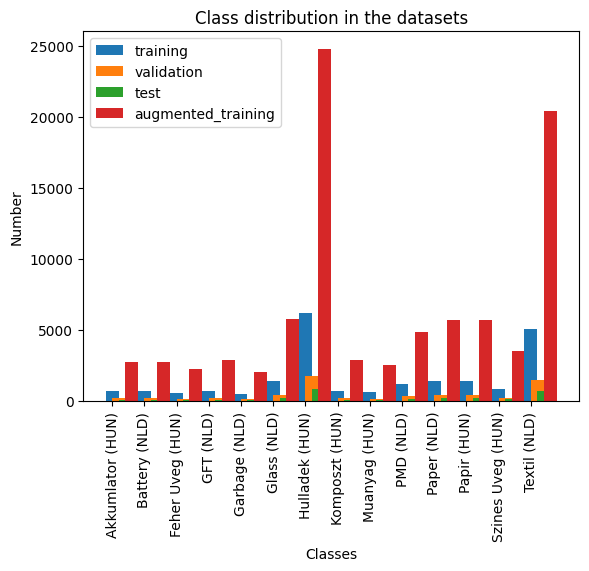

Class distribution percentage in the datasets


DataSet,Akkumlator (HUN),Battery (NLD),Feher Uveg (HUN),GFT (NLD),Garbage (NLD),Glass (NLD),Hulladek (HUN),Komposzt (HUN),Muanyag (HUN),PMD (NLD),Paper (NLD),Papir (HUN),Szines Uveg (HUN),Textil (NLD)
training,3.084%,3.084%,2.508%,3.260%,2.287%,6.475%,27.904%,3.260%,2.837%,5.471%,6.439%,6.439%,3.967%,22.983%
validation,3.076%,3.076%,2.508%,3.265%,2.287%,6.467%,27.918%,3.265%,2.839%,5.473%,6.435%,6.435%,3.959%,22.997%
test,3.070%,3.070%,2.500%,3.259%,2.278%,6.456%,27.943%,3.259%,2.848%,5.475%,6.424%,6.424%,3.956%,23.038%
augmented_training,3.084%,3.084%,2.508%,3.260%,2.287%,6.475%,27.904%,3.260%,2.837%,5.471%,6.439%,6.439%,3.967%,22.983%


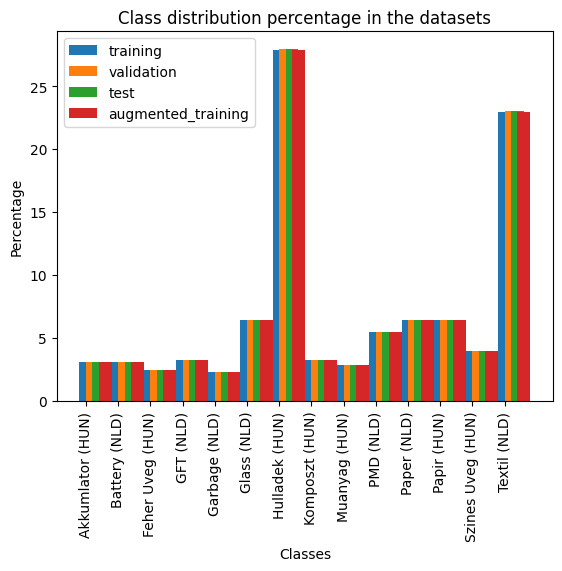

In [23]:
display_dataset_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = False)
plot_datasets_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = False)
display_dataset_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = True)
plot_datasets_class_item_distribution(class_names, cross_ds_stat, ds_stats, percentage = True)

#### Calculate class weights adjustment

Compensate the imbalanced data with class weights for the training.

In [24]:
class_weights = get_class_weights(class_names, cross_ds_stat)

Name,Weight,Label,Cardinality
Akkumlator (HUN),2.690342,0,3717.0
Battery (NLD),2.690342,7,3717.0
Feher Uveg (HUN),3.307972,6,3023.0
GFT (NLD),2.544529,8,3930.0
Garbage (NLD),3.627131,13,2757.0
Glass (NLD),1.281394,9,7804.0
Hulladek (HUN),0.297283,4,33638.0
Komposzt (HUN),2.544529,1,3930.0
Muanyag (HUN),2.923977,5,3420.0
PMD (NLD),1.516300,12,6595.0


#### Extracting the dataset slices to dedicated variables

In [25]:
base_training_ds = prepared_datasets['training']
augmented_training_ds = prepared_datasets['augmented_training'] if active_data_profile.training_ds_augmentation_rounds > 0 else None
validation_ds = prepared_datasets['validation']
test_ds = prepared_datasets['test']

#### Samples from the training dataset

Use the augmented training dataset if available otherwise the training base dataset (not augmented)
One image is displayed from each category with the new class name.

augmented_training [88832]
<CacheDataset element_spec=((TensorSpec(shape=(192, 192, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int8, name=None)), TensorSpec(shape=(), dtype=tf.int8, name=None))>


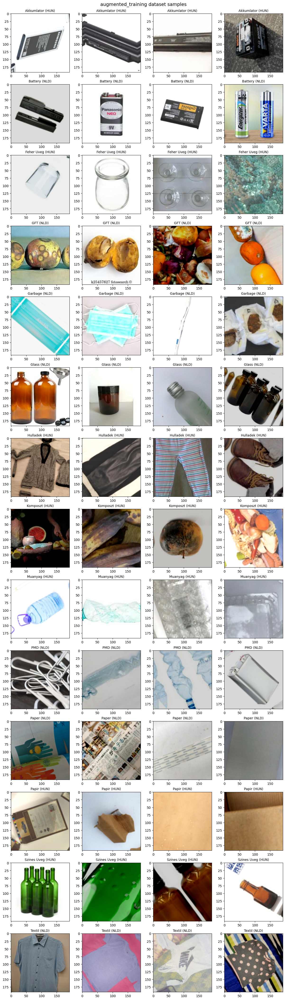

In [26]:
selected_training_ds = augmented_training_ds if augmented_training_ds is not None else base_training_ds
print('%s [%d]' %(selected_training_ds.name, selected_training_ds.cardinality()))
print(selected_training_ds)
display_dataset_samples(selected_training_ds, class_names, 4)
selected_training_ds = None

#### Samples from the validation dataset

One image is displayed from each category with the new class name.

validation [6340]
<CacheDataset element_spec=((TensorSpec(shape=(192, 192, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int8, name=None)), TensorSpec(shape=(), dtype=tf.int8, name=None))>


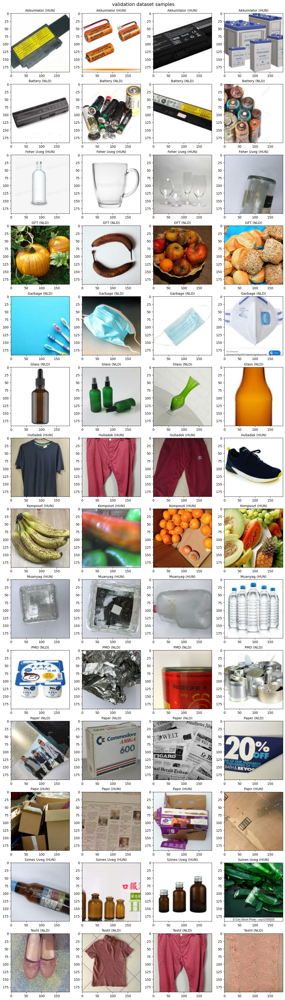

In [27]:
print('%s [%d]' %(validation_ds.name, validation_ds.cardinality()))
print(validation_ds)
display_dataset_samples(validation_ds, class_names, 4)

#### Samples from the test dataset

One image is displayed from each category with the new class name.

test [3160]
<CacheDataset element_spec=((TensorSpec(shape=(192, 192, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int8, name=None)), TensorSpec(shape=(), dtype=tf.int8, name=None))>


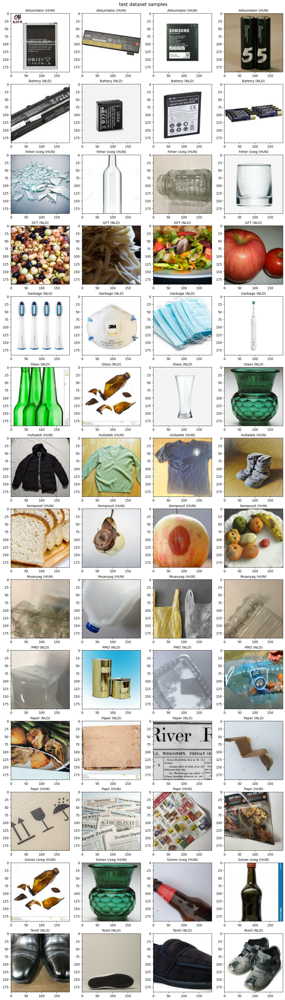

In [28]:
print('%s [%d]' %(test_ds.name, test_ds.cardinality()))
print(test_ds)
display_dataset_samples(test_ds, class_names, 4)

# Choosing a measure of success

Success if the model reaches 90% accuracy on the test dataset.

# Models

### Baseline Model

#### Definition of the Baseline Model 

In [29]:
class BaselineModelConfig(ModelConfig):
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1st', filters = 64, kernel_size = 7, strides = (3, 3), activation = 'relu', padding = 'valid')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_1st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_2st', filters = 128, kernel_size = 5, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_3st', filters = 256, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_5st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Flatten(name = 'image_flatten')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = 256, activation = 'relu')(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = 16, activation = 'relu')(layers)
        return layers
    
    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'merged_dense_1st', units = 128, activation = 'relu')(layers)
        return layers

baseline_run = ModelRun(
    name = 'baseline',
    class_names = class_names,
    image_input_shape = validation_ds.element_spec[0][0],
    data_input_shape = validation_ds.element_spec[0][1],
    model_config = BaselineModelConfig(),
    class_weights = class_weights,
    batch_size = 32,
    epochs = 64,
    data_profile = active_data_profile,
    skip = False,
    silent = False
)


#### Visualize the baseline model

In [30]:
baseline_run.model_summary()

Model: "baseline"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 192, 192, 3)]        0         []                            
                                                                                                  
 image_rescaling (Rescaling  (None, 192, 192, 3)          0         ['image_input[0][0]']         
 )                                                                                                
                                                                                                  
 image_conv_1st (Conv2D)     (None, 62, 62, 64)           9472      ['image_rescaling[0][0]']     
                                                                                                  
 image_conv_1st_max_pool (M  (None, 31, 31, 64)           0         ['image_conv_1st[0][0]'

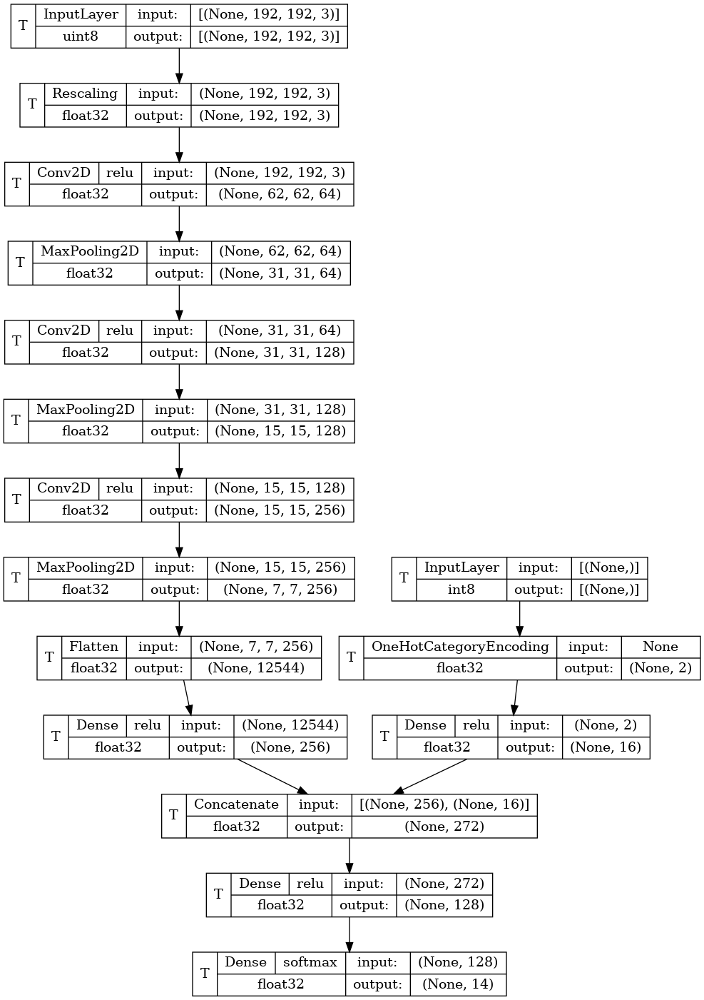

In [31]:
baseline_run.visualize_model()

#### Train the baseline model

In [ ]:
baseline_run.train_model(base_training_ds, validation_ds)

Epoch 1/64


2024-03-11 10:41:04.562224: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 10:41:04.562252: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 10:41:04.562273: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:1883] Profiler found 1 GPUs
2024-03-11 10:41:04.573108: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 10:41:04.573281: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 10:41:04.626847: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 10:41:04.626878: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 10:41:05.460325: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f7290015b10 initialized for platform CUDA (this does not guarante

 11/694 [..............................] - ETA: 18s - loss: 2.6207 - accuracy: 0.0966

2024-03-11 10:41:10.193507: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:70] Profiler session collecting data.
2024-03-11 10:41:10.196362: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 10:41:10.222279: I external/local_xla/xla/backends/profiler/gpu/cupti_collector.cc:541]  GpuTracer has collected 29587 callback api events and 24667 activity events. 
2024-03-11 10:41:10.334385: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 10:41:10.335627: I external/local_tsl/tsl/profiler/rpc/client/save_profile.cc:144] Collecting XSpace to repository: /srv/jupyter/zsalab/data/CM3070-FP/data/complete/tb_log/plugins/profile/2024_03_11_10_41_10/jupyter.xplane.pb


694/694 [==============================] - 15s 14ms/step - loss: 2.2943 - accuracy: 0.2174 - val_loss: 1.5781 - val_accuracy: 0.5112 - lr: 0.0100
Epoch 2/64
694/694 [==============================] - 8s 12ms/step - loss: 1.4480 - accuracy: 0.4891 - val_loss: 1.2810 - val_accuracy: 0.5434 - lr: 0.0100
Epoch 3/64
694/694 [==============================] - 8s 12ms/step - loss: 1.2128 - accuracy: 0.5564 - val_loss: 1.2536 - val_accuracy: 0.5571 - lr: 0.0100
Epoch 4/64
694/694 [==============================] - 8s 12ms/step - loss: 1.0878 - accuracy: 0.6022 - val_loss: 1.0709 - val_accuracy: 0.6004 - lr: 0.0100
Epoch 5/64
694/694 [==============================] - 8s 12ms/step - loss: 0.9778 - accuracy: 0.6412 - val_loss: 0.9067 - val_accuracy: 0.6700 - lr: 0.0100
Epoch 6/64
694/694 [==============================] - 9s 13ms/step - loss: 0.8784 - accuracy: 0.6793 - val_loss: 1.0174 - val_accuracy: 0.6324 - lr: 0.0100
Epoch 7/64
694/694 [==============================] - 8s 12ms/step - loss:

#### Display baseline model training metrics

In [ ]:
baseline_run.display_training_metrics()

#### Evaluate the baseline model

Evaluate the baseline model with the reserved test data.

In [ ]:
baseline_run.evaluate_model(test_ds)

In [ ]:
baseline_run.display_evaluation_metrics()

In [ ]:
baseline_run.predict(test_ds)

In [ ]:
baseline_run.display_prediction_samples()

In [ ]:
baseline_run.display_prediction_confusion_matrix()

In [ ]:
class BaseHyperModelConfig(ModelConfig):
    def __init__(self, hp, **kwargs):
        super().__init__(**kwargs)
        self.hp = hp
        
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1st', filters = 64, kernel_size = 7, strides = (3, 3), activation = 'relu', padding = 'valid')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_1st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_2st', filters = 128, kernel_size = 5, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_3st', filters = 256, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_5st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Flatten(name = 'image_flatten')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = self.hp['data_dense_1st_units'], activation = 'relu')(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = self.hp['data_dense_1st_units'], activation = 'relu')(layers)
        return layers
    
    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'merged_dense_1st', units = self.hp['merged_dense_1st_units'], activation = 'relu')(layers)
        return layers

    def optimizer(self) -> tf.keras.optimizers.Optimizer:
        return tf.keras.optimizers.experimental.SGD(learning_rate = self.hp['learning_rate'])

    def train_callbacks(self, run_name, tb_log_loc, silent) -> list[tf.keras.callbacks.Callback]:
        return [
            FixedKerasTensorBoardCallback(
                    log_dir = tb_log_loc.joinpath(run_name, 'fit', datetime.now().strftime('%H%M%S')),
                    histogram_freq = 5,
                    write_graph = False,
                    write_images = False,
                    update_freq = 5,
                    stop_existing_profiler = False),
            tf.keras.callbacks.EarlyStopping(monitor = 'val_loss', patience = 8, restore_best_weights = False, start_from_epoch = 4, verbose = 0),
            tf.keras.callbacks.ReduceLROnPlateau(monitor = 'val_loss', factor = 0.5, patience = 8, min_lr = 0.00001, verbose = 0)
        ]


hp = {
    'image_dense_1st_units': [ 128, 256, 512 ],
    'data_dense_1st_units': [ 8, 16, 32 ],
    'merged_dense_1st_units': [ 64, 128, 256 ],
    'learning_rate': [ 0.001, 0.0001, 0.00001 ]
}

hyperbase_runs = []
for i, v in enumerate(hps(hp)):
    hyperbase_run = ModelRun(
        name = 'hyperbase%d' %i,
        class_names = class_names,
        image_input_shape = validation_ds.element_spec[0][0],
        data_input_shape = validation_ds.element_spec[0][1],
        model_config = BaseHyperModelConfig(v),
        class_weights = class_weights,
        batch_size = 32,
        epochs = 16,
        data_profile = active_data_profile,
        skip = False,
        silent = True
    )
    hyperbase_run.train_model(base_training_ds, validation_ds)
    hyperbase_runs.append(hyperbase_run)
    
    

## Small Model

Checking the results with a reduced version of the baseline model, to check if the baseline model is too small or to big

### Definition of the Small Model

In [158]:
class SmallModelConfig(ModelConfig):
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1st', filters = 32, kernel_size = 7, strides = (3, 3), activation = 'relu', padding = 'valid')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_1st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_2st', filters = 64, kernel_size = 5, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_3st', filters = 128, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_4st', filters = 128, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_5st', filters = 64, kernel_size = 1, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_5st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Flatten(name = 'image_flatten')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = 128, activation = 'relu')(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = 8, activation = 'relu')(layers)
        return layers
    
    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'merged_dense_1st', units = 32, activation = 'relu')(layers)
        return layers

    def train_callback_early_stopping(self, silent) -> tf.keras.callbacks.Callback:
        return None

    def train_callback_reduce_lr_on_plateau(self, silent) -> tf.keras.callbacks.Callback:
        return None

smallmodel_run = ModelRun(
    name = 'smallmodel',
    class_names = class_names,
    image_input_shape = validation_ds.element_spec[0][0],
    data_input_shape = validation_ds.element_spec[0][1],
    model_config = SmallModelConfig(),
    class_weights = class_weights,
    batch_size = 32,
    epochs = 64,
    data_profile = active_data_profile,
    skip = False,
    silent = False
)


In [159]:
smallmodel_run.model_summary()

Model: "smallmodel"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 192, 192, 3)]        0         []                            
                                                                                                  
 image_rescaling (Rescaling  (None, 192, 192, 3)          0         ['image_input[0][0]']         
 )                                                                                                
                                                                                                  
 image_conv_1st (Conv2D)     (None, 62, 62, 32)           4736      ['image_rescaling[0][0]']     
                                                                                                  
 image_conv_1st_max_pool (M  (None, 31, 31, 32)           0         ['image_conv_1st[0][0

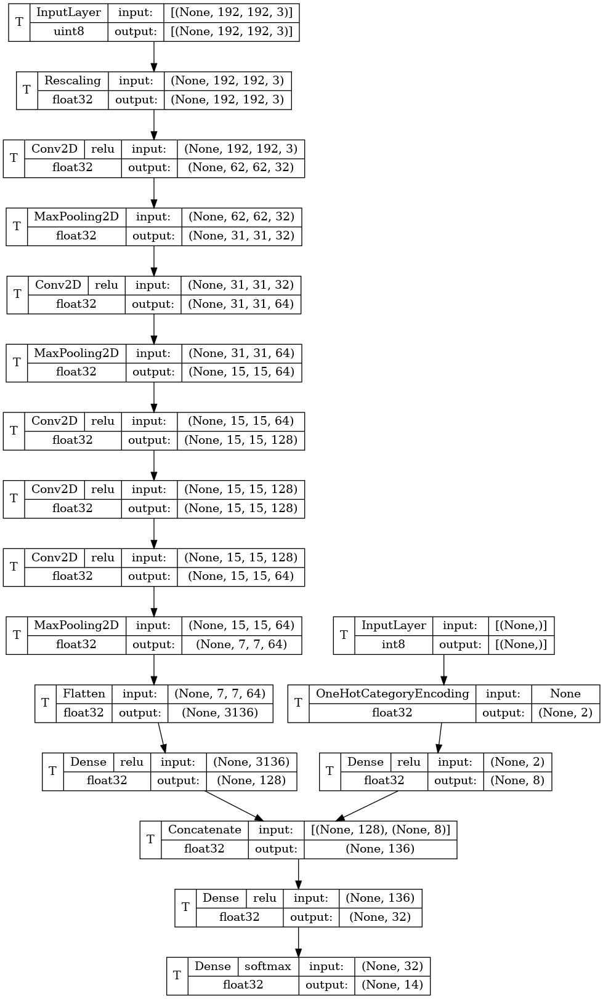

In [160]:
smallmodel_run.visualize_model()

In [161]:
smallmodel_run.train_model(base_training_ds, validation_ds)

Epoch 1/64


2024-03-11 05:52:54.535940: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 05:52:54.535992: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 05:52:54.547910: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 05:52:54.623266: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 05:52:54.695356: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 05:52:54.695383: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.


 10/694 [..............................] - ETA: 19s - loss: 2.6048 - accuracy: 0.2313 

2024-03-11 05:52:57.118247: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:70] Profiler session collecting data.
2024-03-11 05:52:57.162806: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 05:52:57.211464: I external/local_xla/xla/backends/profiler/gpu/cupti_collector.cc:541]  GpuTracer has collected 1115 callback api events and 997 activity events. 
2024-03-11 05:52:57.228478: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 05:52:57.228646: I external/local_tsl/tsl/profiler/rpc/client/save_profile.cc:144] Collecting XSpace to repository: /srv/jupyter/zsalab/data/CM3070-FP/data/complete/tb_log/plugins/profile/2024_03_11_05_52_57/jupyter.xplane.pb


694/694 [==============================] - 11s 12ms/step - loss: 2.5396 - accuracy: 0.1342 - val_loss: 2.2335 - val_accuracy: 0.2041
Epoch 2/64
694/694 [==============================] - 7s 10ms/step - loss: 1.7866 - accuracy: 0.3470 - val_loss: 1.4634 - val_accuracy: 0.4583
Epoch 3/64
694/694 [==============================] - 7s 10ms/step - loss: 1.3996 - accuracy: 0.4871 - val_loss: 1.2320 - val_accuracy: 0.5532
Epoch 4/64
694/694 [==============================] - 7s 10ms/step - loss: 1.2559 - accuracy: 0.5393 - val_loss: 1.1746 - val_accuracy: 0.5734
Epoch 5/64
694/694 [==============================] - 7s 10ms/step - loss: 1.1617 - accuracy: 0.5732 - val_loss: 1.0444 - val_accuracy: 0.6163
Epoch 6/64
694/694 [==============================] - 7s 10ms/step - loss: 1.0684 - accuracy: 0.6103 - val_loss: 1.0887 - val_accuracy: 0.6051
Epoch 7/64
694/694 [==============================] - 7s 10ms/step - loss: 0.9939 - accuracy: 0.6402 - val_loss: 1.0483 - val_accuracy: 0.6310
Epoch 8/6

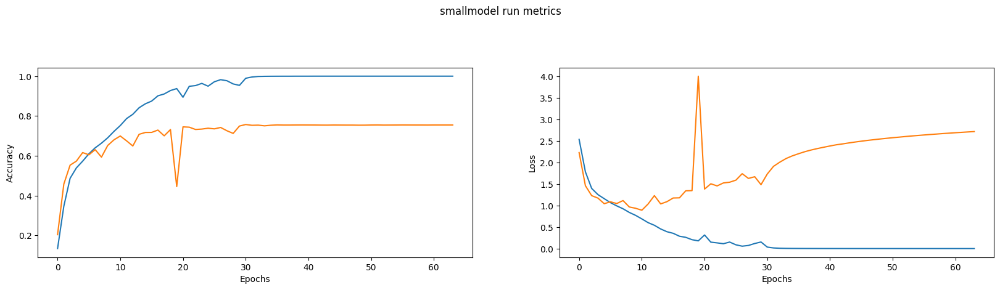

In [162]:
smallmodel_run.display_training_metrics()

In [163]:
smallmodel_run.evaluate_model(test_ds)

98/98 [==============================] - 0s 4ms/step - loss: 2.5130 - accuracy: 0.7701


In [154]:
smallmodel_run.display_evaluation_metrics()

[smallmodel] Test loss: 2.361634; Test accuracy: 0.768495


In [155]:
smallmodel_run.predict(test_ds)

98/98 [==============================] - 1s 4ms/step


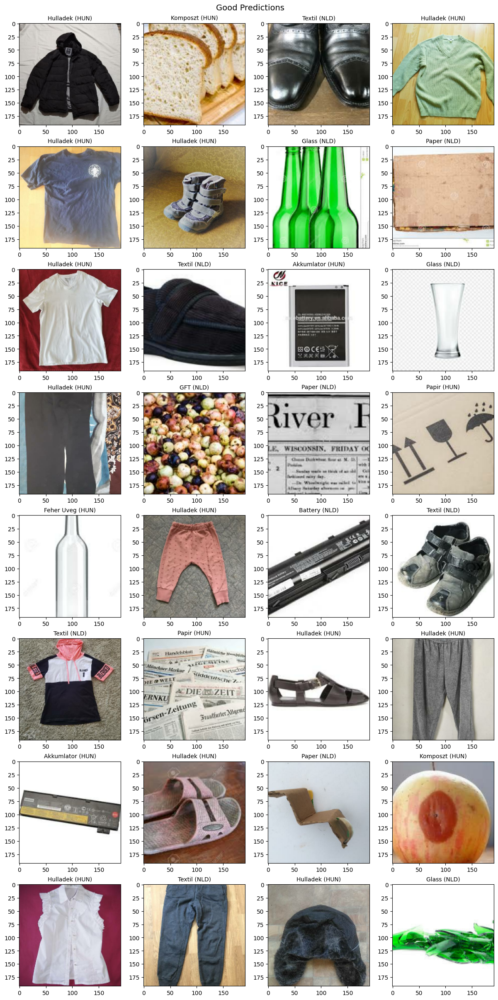

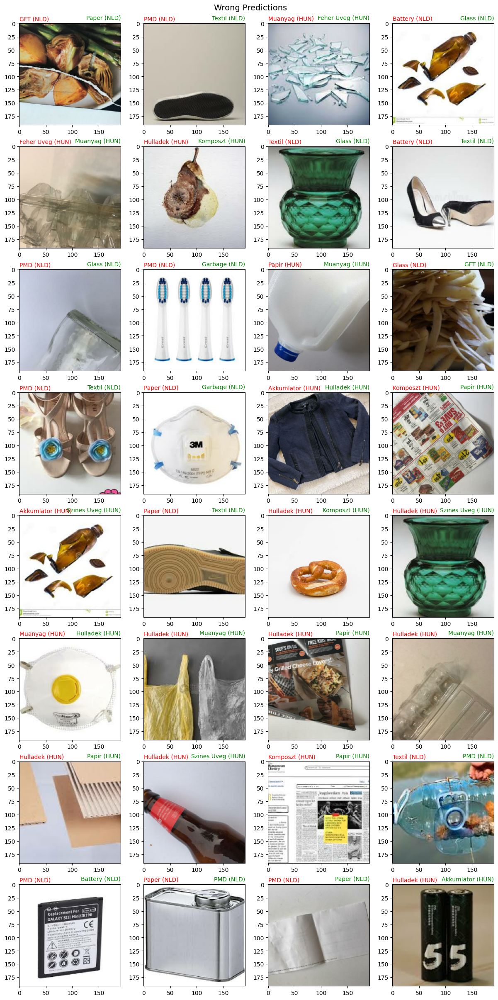

In [156]:
smallmodel_run.display_prediction_samples()

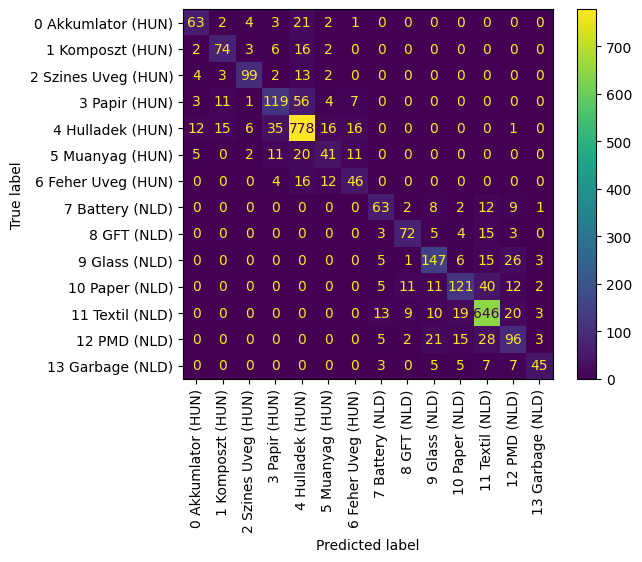

In [157]:
smallmodel_run.display_prediction_confusion_matrix()

Epoch 1/32


2024-03-11 06:44:48.376459: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 06:44:48.376495: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 06:44:48.384976: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 06:44:48.460426: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 06:44:48.541375: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 06:44:48.541436: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.


  3/694 [..............................] - ETA: 1:17 - loss: 2.6935 - accuracy: 0.0000e+00 WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0042s vs `on_train_batch_end` time: 0.0420s). Check your callbacks.


2024-03-11 06:44:50.313902: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:70] Profiler session collecting data.
2024-03-11 06:44:50.375797: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 06:44:50.454688: I external/local_xla/xla/backends/profiler/gpu/cupti_collector.cc:541]  GpuTracer has collected 375 callback api events and 344 activity events. 
2024-03-11 06:44:50.466136: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 06:44:50.466290: I external/local_tsl/tsl/profiler/rpc/client/save_profile.cc:144] Collecting XSpace to repository: /srv/jupyter/zsalab/data/CM3070-FP/data/complete/tb_log/plugins/profile/2024_03_11_06_44_50/jupyter.xplane.pb


694/694 [==============================] - 8s 9ms/step - loss: 2.5011 - accuracy: 0.1676 - val_loss: 2.2146 - val_accuracy: 0.3166
Epoch 2/32
694/694 [==============================] - 6s 9ms/step - loss: 1.9788 - accuracy: 0.3206 - val_loss: 1.4899 - val_accuracy: 0.5327
Epoch 3/32
694/694 [==============================] - 6s 8ms/step - loss: 1.6078 - accuracy: 0.4188 - val_loss: 1.4602 - val_accuracy: 0.4804
Epoch 4/32
694/694 [==============================] - 6s 9ms/step - loss: 1.4347 - accuracy: 0.4737 - val_loss: 1.3437 - val_accuracy: 0.5008
Epoch 5/32
694/694 [==============================] - 6s 9ms/step - loss: 1.3241 - accuracy: 0.5141 - val_loss: 1.2675 - val_accuracy: 0.5355
Epoch 6/32
694/694 [==============================] - 6s 8ms/step - loss: 1.2368 - accuracy: 0.5444 - val_loss: 1.1651 - val_accuracy: 0.5631
Epoch 7/32
694/694 [==============================] - 6s 9ms/step - loss: 1.1766 - accuracy: 0.5649 - val_loss: 1.2229 - val_accuracy: 0.5513
Epoch 8/32
694/69

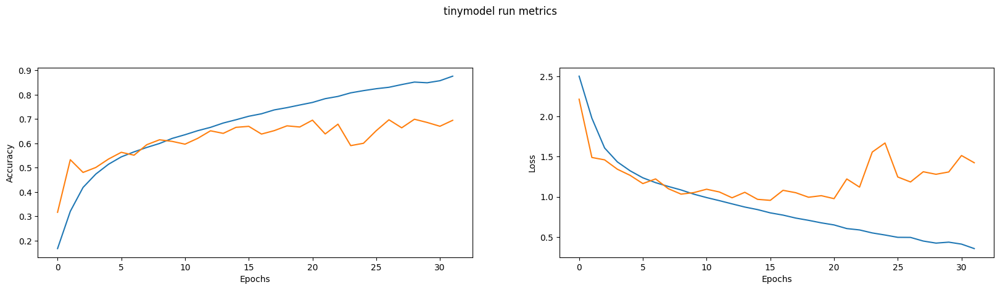

In [177]:
class TinyModelConfig(ModelConfig):
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1st', filters = 16, kernel_size = 7, strides = (3, 3), activation = 'relu', padding = 'valid')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_1st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_2st', filters = 32, kernel_size = 5, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        #layers = tf.keras.layers.Conv2D(name = 'image_conv_3st', filters = 64, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        #layers = tf.keras.layers.Conv2D(name = 'image_conv_4st', filters = 32, kernel_size = 1, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_4st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Flatten(name = 'image_flatten')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = 16, activation = 'relu')(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        #layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = 4, activation = 'relu')(layers)
        return layers
    
    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'merged_dense_1st', units = 16, activation = 'relu')(layers)
        return layers

    def train_callback_early_stopping(self, silent) -> tf.keras.callbacks.Callback:
        return None

    def train_callback_reduce_lr_on_plateau(self, silent) -> tf.keras.callbacks.Callback:
        return None

tinymodel_run = ModelRun(
    name = 'tinymodel',
    class_names = class_names,
    image_input_shape = validation_ds.element_spec[0][0],
    data_input_shape = validation_ds.element_spec[0][1],
    model_config = TinyModelConfig(),
    class_weights = class_weights,
    batch_size = 32,
    epochs = 32,
    data_profile = active_data_profile,
    skip = False,
    silent = False
)
tinymodel_run.train_model(base_training_ds, validation_ds)
tinymodel_run.display_training_metrics()

## Normalized model

### Definition of the Normalized model

In [178]:
tinymodel_run.evaluate_model(test_ds)
#from tensorboard import notebook
#notebook.list()
#%tensorboard --logdir=/srv/jupyter/zsalab/data/CM3070-FP/data/complete/tb_log/ --bind_all

98/98 [==============================] - 0s 4ms/step - loss: 1.3389 - accuracy: 0.7006


In [182]:
class NormalizedModelConfig(ModelConfig):
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1st', filters = 128, kernel_size = 7, strides = (3, 3), activation = 'relu', padding = 'valid')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_1st_batch_norm')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_1st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_2st', filters = 256, kernel_size = 5, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_2st_batch_norm')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        #layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_2st_max_pool', pool_size = (3, 3), strides = (2, 2))(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_3st', filters = 256, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_3st_batch_norm')(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_4st', filters = 256, kernel_size = 3, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_4st_batch_norm')(layers)
        layers = tf.keras.layers.Conv2D(name = 'image_conv_5st', filters = 256, kernel_size = 1, strides = (1, 1), activation = 'relu', padding = 'same')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_5st_batch_norm')(layers)
        layers = tf.keras.layers.MaxPooling2D(name = 'image_conv_5st_max_pool', pool_size = (2, 2), strides = (2, 2))(layers)
        layers = tf.keras.layers.Flatten(name = 'image_flatten')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = 512, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'image_dense_1st_dropout', rate = 0.25)(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_2st', units = 512, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'image_dense_2st_dropout', rate = 0.25)(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = 64, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'data_dense_1st_dropout', rate = 0.25)(layers)
        return layers

    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'common_dense_1st', units = 256, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'common_dense_1st_dropout', rate = 0.25)(layers)
        layers = tf.keras.layers.Dense(name = 'common_dense_2st', units = 256, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'common_dense_2st_dropout', rate = 0.25)(layers)
        return layers

    def optimizer(self) -> tf.keras.optimizers.Optimizer:
        #return tf.keras.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.007)
        #return tf.keras.optimizers.experimental.SGD(learning_rate = 0.01, momentum = 0.9)
        return tf.keras.optimizers.experimental.SGD(learning_rate = 0.001, momentum = 0.9, weight_decay = 0.003)
    '''
    def eagerly(self):
        return True
    '''


normalized_run = ModelRun(
    name = 'normalized',
    class_names = class_names,
    image_input_shape = validation_ds.element_spec[0][0],
    data_input_shape = validation_ds.element_spec[0][1],
    model_config = NormalizedModelConfig(),
    class_weights = class_weights,
    batch_size = 64,
    epochs = 128,
    data_profile = active_data_profile,
    skip = False,
    silent = False
)


### Visualization of the Normalized model

In [183]:
normalized_run.model_summary()

Model: "normalized"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 192, 192, 3)]        0         []                            
                                                                                                  
 image_rescaling (Rescaling  (None, 192, 192, 3)          0         ['image_input[0][0]']         
 )                                                                                                
                                                                                                  
 image_conv_1st (Conv2D)     (None, 62, 62, 128)          18944     ['image_rescaling[0][0]']     
                                                                                                  
 image_conv_1st_batch_norm   (None, 62, 62, 128)          512       ['image_conv_1st[0][0

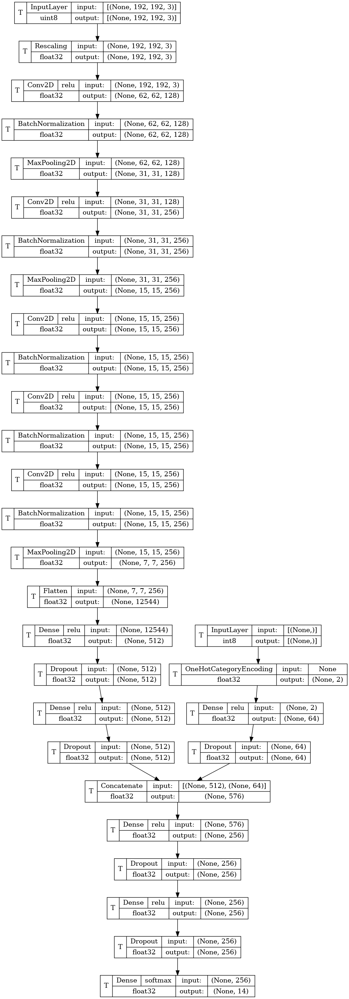

In [184]:
normalized_run.visualize_model()

### Training of the Normalized model

In [185]:
normalized_model_training_ds = augmented_training_ds if augmented_training_ds is not None else base_training_ds
#normalized_model_training_ds = base_training_ds

normalized_run.train_model(normalized_model_training_ds, validation_ds)

normalized_model_training_ds = None

2024-03-11 06:56:00.527596: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 06:56:00.527652: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 06:56:00.542155: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 06:56:00.649855: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed


Epoch 1/128


2024-03-11 06:56:00.747453: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-03-11 06:56:00.747486: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-03-11 06:56:02.231749: W tensorflow/compiler/tf2xla/kernels/random_ops.cc:59] Warning: Using tf.random.uniform with XLA compilation will ignore seeds; consider using tf.random.stateless_uniform instead if reproducible behavior is desired. normalized/common_dense_1st_dropout/dropout/random_uniform/RandomUniform


   1/1388 [..............................] - ETA: 4:34:56 - loss: 3.4722 - accuracy: 0.0625

2024-03-11 06:56:12.762764: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:70] Profiler session collecting data.
2024-03-11 06:56:12.833219: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:2017] CUPTI activity buffer flushed
2024-03-11 06:56:12.915504: I external/local_xla/xla/backends/profiler/gpu/cupti_collector.cc:541]  GpuTracer has collected 51603 callback api events and 44880 activity events. 


   5/1388 [..............................] - ETA: 3:34 - loss: 3.3853 - accuracy: 0.0469 WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0076s vs `on_train_batch_end` time: 0.1138s). Check your callbacks.


2024-03-11 06:56:13.106821: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-03-11 06:56:13.107032: I external/local_tsl/tsl/profiler/rpc/client/save_profile.cc:144] Collecting XSpace to repository: /srv/jupyter/zsalab/data/CM3070-FP/data/complete/tb_log/plugins/profile/2024_03_11_06_56_13/jupyter.xplane.pb


1388/1388 [==============================] - 65s 39ms/step - loss: 2.1065 - accuracy: 0.2900 - val_loss: 1.8083 - val_accuracy: 0.3870 - lr: 0.0010
Epoch 2/128
1388/1388 [==============================] - 52s 38ms/step - loss: 1.2966 - accuracy: 0.5415 - val_loss: 1.5194 - val_accuracy: 0.5601 - lr: 0.0010
Epoch 3/128
1388/1388 [==============================] - 53s 38ms/step - loss: 1.1422 - accuracy: 0.5893 - val_loss: 1.0287 - val_accuracy: 0.6283 - lr: 0.0010
Epoch 4/128
1388/1388 [==============================] - 52s 38ms/step - loss: 1.0448 - accuracy: 0.6234 - val_loss: 0.8637 - val_accuracy: 0.6730 - lr: 0.0010
Epoch 5/128
1388/1388 [==============================] - 53s 38ms/step - loss: 0.9597 - accuracy: 0.6521 - val_loss: 0.7884 - val_accuracy: 0.7162 - lr: 0.0010
Epoch 6/128
1388/1388 [==============================] - 53s 38ms/step - loss: 0.8886 - accuracy: 0.6774 - val_loss: 0.9846 - val_accuracy: 0.6545 - lr: 0.0010
Epoch 7/128
1388/1388 [=============================

### Training Metrics of the Normalized model

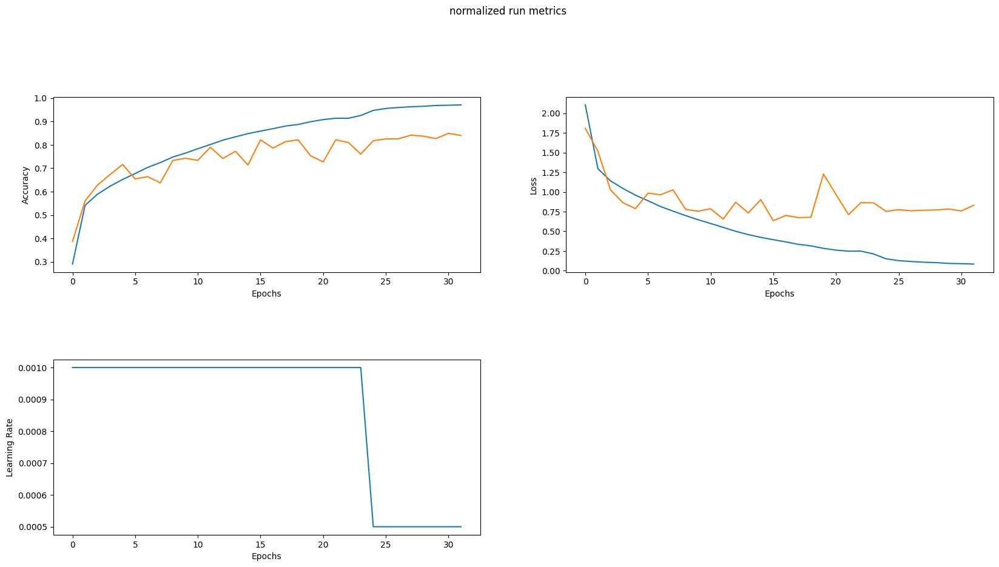

In [187]:
normalized_run.display_training_metrics()

### Evaluation of the Normalized model

In [188]:
normalized_run.evaluate_model(test_ds)

49/49 [==============================] - 1s 12ms/step - loss: 0.5921 - accuracy: 0.8233


In [189]:
normalized_run.display_evaluation_metrics()

[normalized] Test loss: 0.592086; Test accuracy: 0.823342


In [190]:
normalized_run.predict(test_ds)

49/49 [==============================] - 1s 10ms/step


### Display prediction samples of the Normalized model

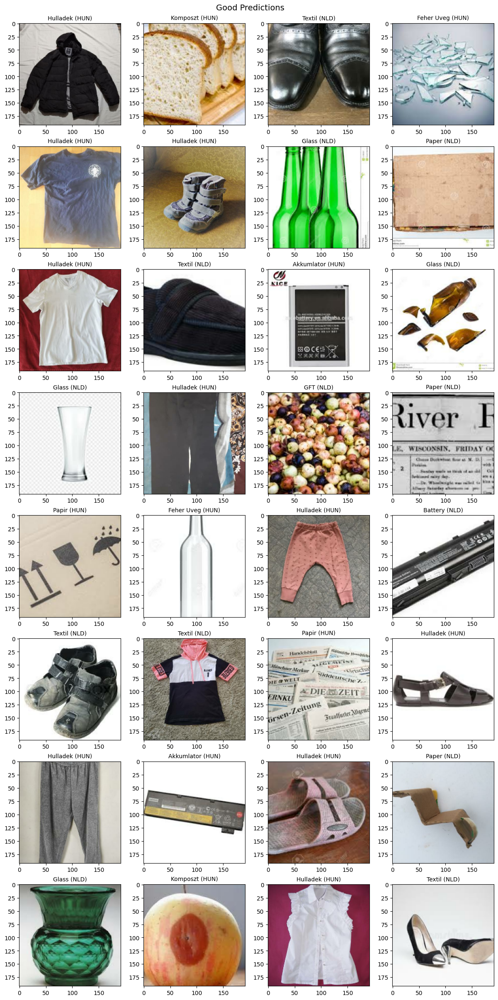

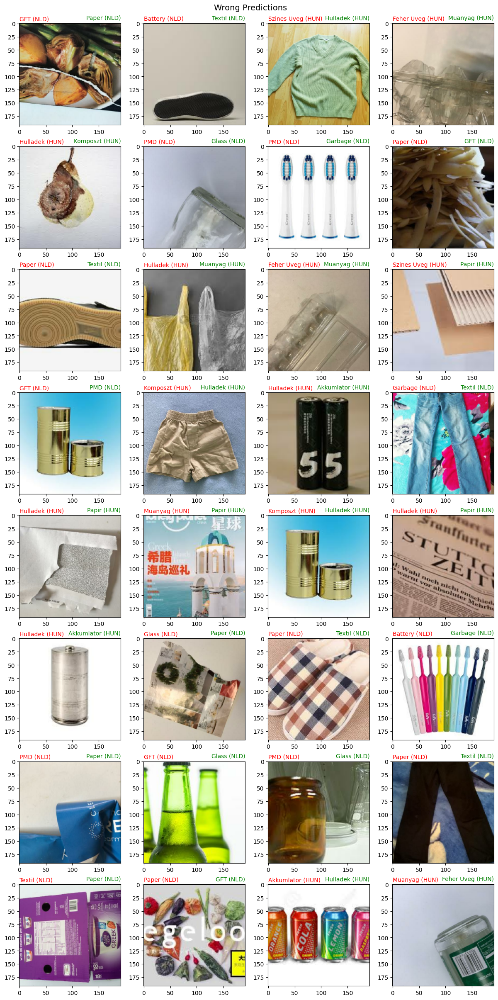

In [191]:
normalized_run.display_prediction_samples()

### Confusion Matrix of the Normalized model

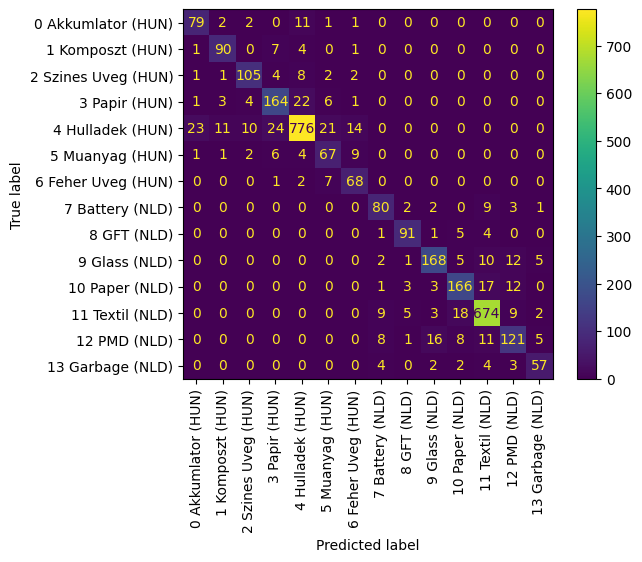

In [45]:
normalized_run.display_prediction_confusion_matrix()

## ConvMix model

### Definition of the ConvMix model

In [44]:
class ConvMixModelConfig(ModelConfig):
    _filters: int
    _depth: int
    _kernel_size: int
    _patch_size: int
    
    def __init__(self, filters = 256, depth = 6, kernel_size = 9, patch_size = 7):
        self._filters = filters
        self._depth = depth
        self._kernel_size = kernel_size
        self._patch_size = patch_size
        
    def image_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Conv2D(name = 'image_conv_1_stem', filters = self._filters, kernel_size = self._kernel_size, strides = self._patch_size, activation = 'gelu')(layers)
        layers = tf.keras.layers.BatchNormalization(name = 'image_conv_1_stem_batch_norm')(layers)

        for i in range(self._depth):
            idx = i + 2
            prev_layers = layers
            layers = tf.keras.layers.DepthwiseConv2D(name = 'image_conv_%d_deptwise' %idx, kernel_size = self._kernel_size, padding = 'same', activation = 'gelu')(layers)
            layers = tf.keras.layers.BatchNormalization(name = 'image_conv_%d_deptwise_batch_norm' %idx)(layers)
            layers = tf.keras.layers.Add(name = 'image_conv_%d_add' %idx)([layers, prev_layers])  # Residual.

            # Pointwise convolution.
            layers = tf.keras.layers.Conv2D(name = 'image_conv_%d' %idx, filters = self._filters, kernel_size = 1, activation = 'gelu')(layers)
            layers = tf.keras.layers.BatchNormalization(name = 'image_conv_%d_batch_norm' %idx)(layers)

        layers = tf.keras.layers.GlobalAvgPool2D(name = 'image_flatten_glob_avg_pool')(layers)
        layers = tf.keras.layers.Dense(name = 'image_dense_1st', units = 512, activation = 'relu')(layers)
        #layers = tf.keras.layers.Dense(name = 'image_dense_2st', units = 512, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'image_dense_1st_dropout', rate = 0.2)(layers)
        return layers

    def data_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'data_dense_1st', units = 64, activation = 'relu')(layers)
        #layers = tf.keras.layers.Dense(name = 'data_dense_2st', units = 128, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'data_dense_1st_dropout', rate = 0.2)(layers)
        return layers

    def common_hidden_layers(self, layers: tf.keras.layers.Layer) -> tf.keras.layers.Layer:
        layers = tf.keras.layers.Dense(name = 'common_dense_1st', units = 256, activation = 'relu')(layers)
        #layers = tf.keras.layers.Dense(name = 'common_dense_2st', units = 256, activation = 'relu')(layers)
        layers = tf.keras.layers.Dropout(name = 'common_dense_2st_dropout', rate = 0.2)(layers)
        return layers

    def optimizer(self) -> tf.keras.optimizers.Optimizer:
        #return tf.keras.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.007)
        return tf.keras.optimizers.experimental.SGD(learning_rate = 0.01, momentum = 0.9)

convmix_run = ModelRun(
    name = 'convmix',
    class_names = class_names,
    image_input_shape = validation_ds.element_spec[0][0].shape,
    data_input_shape = validation_ds.element_spec[0][1].shape,
    model_config = ConvMixModelConfig(),
    class_weights = class_weights,
    batch_size = 64,
    epochs = 128,
    data_profile = active_data_profile,
    skip = False,
    silent = False
)


### Visualization of the ConvMix model

In [45]:
convmix_run.model_summary()

Model: "convmix"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 192, 192, 3)]        0         []                            
                                                                                                  
 image_rescaling (Rescaling  (None, 192, 192, 3)          0         ['image_input[0][0]']         
 )                                                                                                
                                                                                                  
 image_conv_1_stem (Conv2D)  (None, 27, 27, 256)          62464     ['image_rescaling[0][0]']     
                                                                                                  
 image_conv_1_stem_batch_no  (None, 27, 27, 256)          1024      ['image_conv_1_stem[0][0

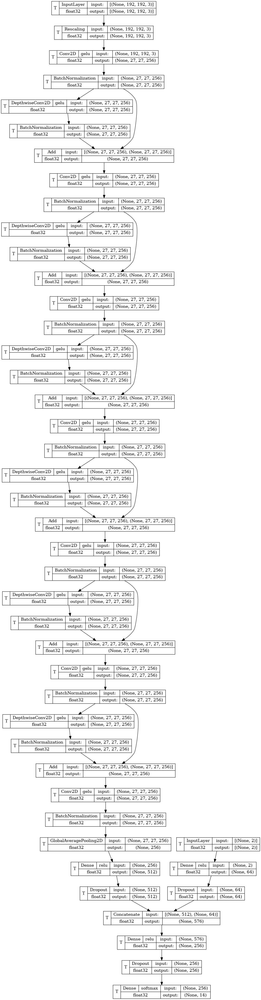

In [46]:
convmix_run.visualize_model()

### Training of the ConvMix model

In [47]:
convmix_model_training_ds = augmented_training_ds if augmented_training_ds is not None else base_training_ds

convmix_run.train_model(convmix_model_training_ds, validation_ds)
convmix_model_training_ds = None

ERROR:tensorflow:Failed to start profiler: Another profiler is running.
Epoch 1/128
ERROR:tensorflow:Failed to start profiler: Another profiler is running.
1388/1388 [==============================] - 159s 107ms/step - loss: 1.3670 - accuracy: 0.5006 - val_loss: 0.9680 - val_accuracy: 0.6364 - lr: 0.0100
Epoch 2/128
1388/1388 [==============================] - 149s 107ms/step - loss: 1.0418 - accuracy: 0.6180 - val_loss: 1.0583 - val_accuracy: 0.6196 - lr: 0.0100
Epoch 3/128
1388/1388 [==============================] - 149s 107ms/step - loss: 0.9037 - accuracy: 0.6690 - val_loss: 1.2529 - val_accuracy: 0.6076 - lr: 0.0100
Epoch 4/128
1388/1388 [==============================] - 149s 107ms/step - loss: 0.7844 - accuracy: 0.7118 - val_loss: 0.8256 - val_accuracy: 0.7099 - lr: 0.0100
Epoch 5/128
1388/1388 [==============================] - 149s 107ms/step - loss: 0.6843 - accuracy: 0.7484 - val_loss: 0.7758 - val_accuracy: 0.7347 - lr: 0.0100
Epoch 6/128
1388/1388 [=======================

### Training Metrics of the ConvMix model

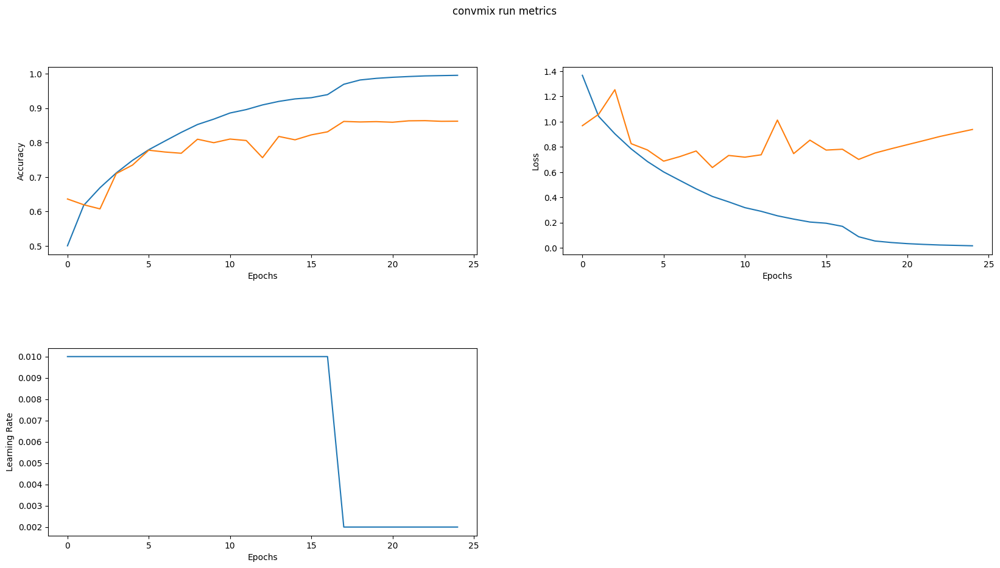

In [48]:
convmix_run.display_training_metrics()

### Evaluation of the ConvMix model

In [49]:
convmix_run.evaluate_model(test_ds)

49/49 [==============================] - 1s 28ms/step - loss: 0.5852 - accuracy: 0.8160


In [50]:
convmix_run.display_evaluation_metrics()

[convmix] Test loss: 0.585199; Test accuracy: 0.816008


In [51]:
convmix_run.predict(test_ds)

49/49 [==============================] - 2s 27ms/step


### Display prediction samples of the ConvMix model

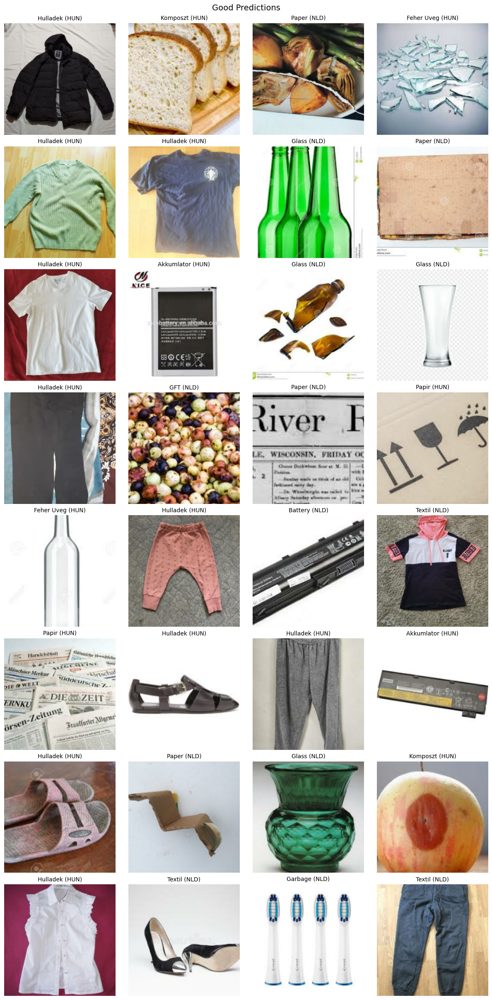

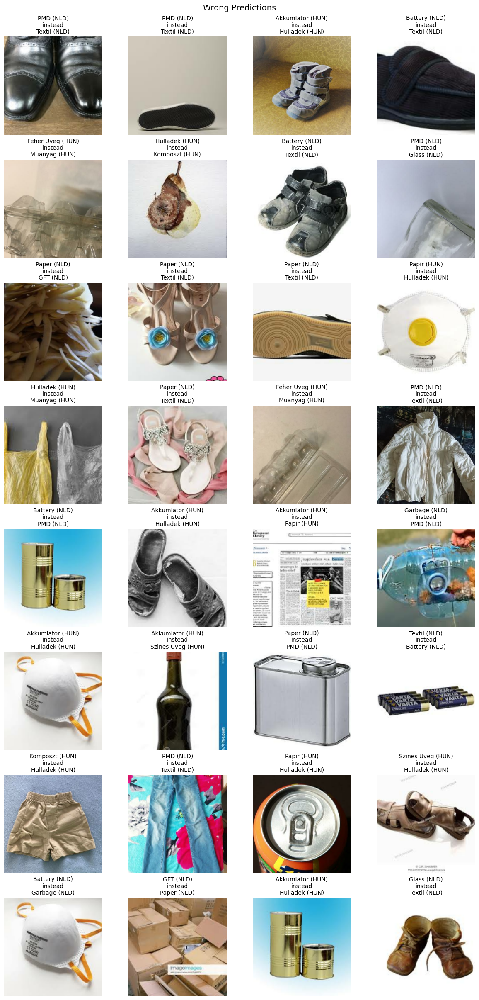

In [52]:
convmix_run.display_prediction_samples()

### Confusion Matrix of the ConvMix model

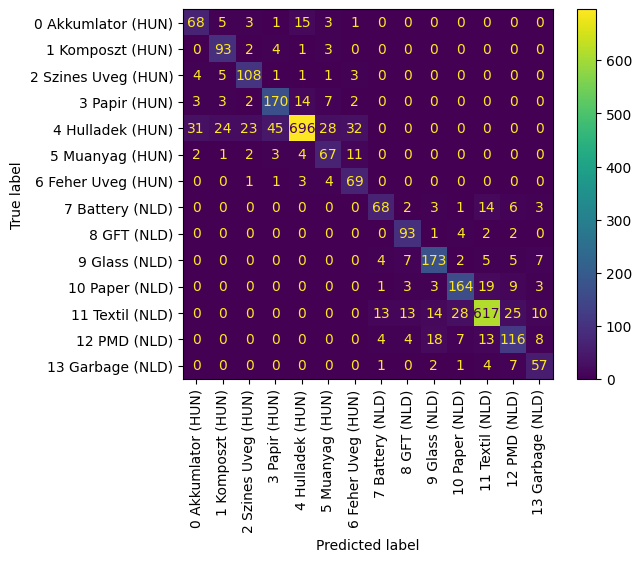

In [53]:
convmix_run.display_prediction_confusion_matrix()

In [ ]:
a

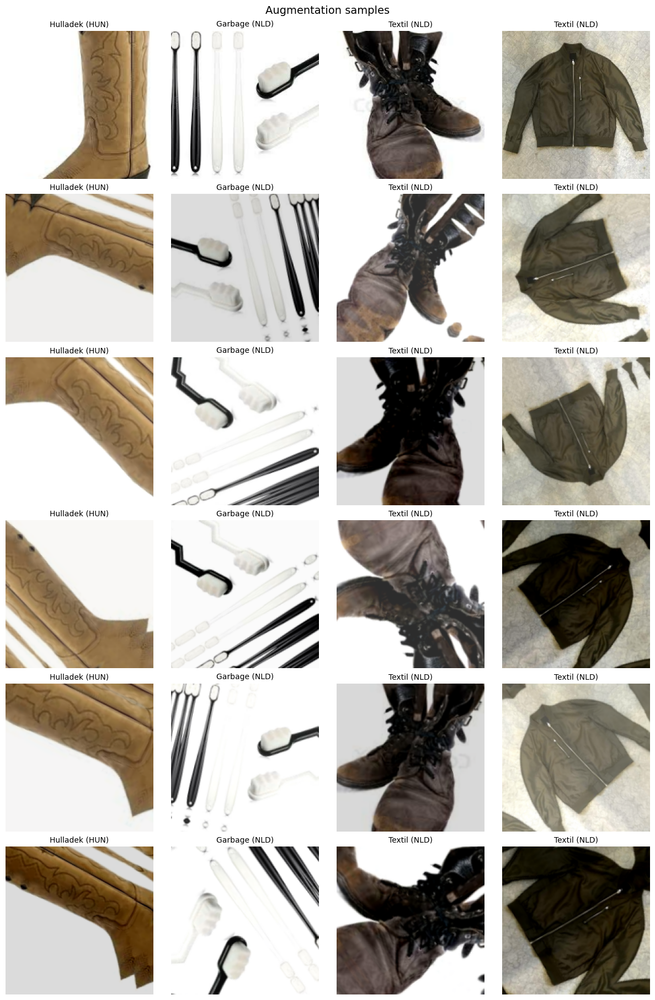

In [85]:
#tds = training_ds.skip(22100)
#tds.name = 'tds'
#display_dataset_samples(tds, class_names, 4)
#print(class_weights)

vds = validation_ds.skip(40).take(40)
avds = augment_dataset(vds, class_names, 5)

#sam = []
#for x, y in avds.as_numpy_iterator():
#    sam.append((x[0], '%d %s' %(x[1][0], class_names[y])))
#display_samples(sam)

In [ ]:
def plot_image(i, predictions_array, true_label, img):
  true_label, img = true_label[i], img[i]
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(predictions_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(predictions_array),
                                class_names[true_label]),
                                color=color)

def plot_value_array(i, predictions_array, true_label):
  true_label = true_label[i]
  plt.grid(False)
  plt.xticks(range(len(predictions_array)))
  plt.yticks([])
  thisplot = plt.bar(range(len(predictions_array)), predictions_array, color="#777777")
  #plt.ylim([0, 1])
  predicted_label = np.argmax(predictions_array)

  thisplot[predicted_label].set_color('red')
  thisplot[true_label].set_color('blue')

def pred(class_names, predict_ds):
    for i in range(predict_ds.cardinality()):
        p1_ds = predict_ds.skip(i).take(1)
        p1_ds.name = '%s-%d' %(predict_ds.name, i)
        assert p1_ds.cardinality() == 1
        batched_predict_ds = normalized_run._batched_dataset(p1_ds, 1)
        pred = normalized_run._model.predict(batched_predict_ds, batch_size = None, verbose = 1)
        assert len(pred) == 1
        pred_label = np.argmax(pred)
        for sample, true_label in p1_ds.as_numpy_iterator():
            if true_label != pred_label:
                print('%d %d [%s %s]' %(true_label, pred_label, class_names[true_label], class_names[pred_label]))
                #plt.figure()
                #plt.imshow(sample[0])
                #plt.colorbar()
                #plt.grid(False)
                #plt.show()
                plt.figure(figsize=(6,3))
                plt.subplot(1,2,1)
                plot_image(0, pred[0], [true_label], sample)
                plt.subplot(1,2,2)
                plot_value_array(0, pred[0], [true_label])
                plt.show()
                print(pred[0])
                return

pred(class_names, test_ds)

In [40]:
image_conv_filters_opts = [ (128, 64, 32), (64, 64, 64), (32, 64, 128) ]
image_dense_unit_opts = [ 64, 128 ]
# image_dense_dropout_opts = [ 0.2, 0.5 ]
image_dense_dropout_opts = [ 0.5 ]
data_dense_unit_opts = [ 16, 32 ]
# data_dense_dropout_opts = [ 0.2, 0.5 ]
data_dense_dropout_opts = [ 0.5 ]
common_dense_unit_opts = [ 64, 128 ]
# common_dense_dropout_opts = [ 0.2, 0.5 ]
common_dense_dropout_opts = [ 0.2 ]
# learn_rate_opts = [ 0.0001, 0.001 ]
learn_rate_opts = [ 0.001 ]
batch_size_opts = [ 64, 32, 16 ]
epochs_opts = [ 32 ] # early stop callback will limit epochs if needed

candidates = []
for image_conv_filters in image_conv_filters_opts:
    for image_dense_unit in image_dense_unit_opts:
        for image_dense_dropout in image_dense_dropout_opts:
            for data_dense_unit in data_dense_unit_opts:
                for data_dense_dropout in data_dense_dropout_opts:
                    for common_dense_unit in common_dense_unit_opts:
                        for common_dense_dropout in common_dense_dropout_opts:
                            for learn_rate in learn_rate_opts:
                                candidate_model_name = 'icf%s-id%d-%.2f-dd%d-%.2f-cd%d-%.2f-lr%.4f' %('_'.join([str(i) for i in image_conv_filters]), 
                                                                                                              image_dense_unit,
                                                                                                              image_dense_dropout,
                                                                                                              data_dense_unit,
                                                                                                              data_dense_dropout,
                                                                                                              common_dense_unit,
                                                                                                              common_dense_dropout,
                                                                                                              learn_rate
                                                                                                             )
                                candidate_model_conf = ModelConfig(
                                    name = candidate_model_name,
                                    image_input_shape = base_training_ds.element_spec[0][0].shape,
                                    data_input_shape = base_training_ds.element_spec[0][1].shape,
                                    class_count = len(class_names),
                                    image_layers = [
                                        ConvLayerConfig(name = 'image_conv_1st', filters = image_conv_filters[0], kernel_size = 3, max_pooling = 2), 
                                        ConvLayerConfig(name = 'image_conv_2st', filters = image_conv_filters[1], kernel_size = 3, max_pooling = 2), 
                                        ConvLayerConfig(name = 'image_conv_3st', filters = image_conv_filters[2], kernel_size = 3, max_pooling = 2, batch_normalization = True, flatten = True), 
                                        DenseLayerConfig(name = 'image_dense_1st', units = image_dense_unit, dropout = image_dense_dropout)
                                    ],
                                    data_layers = [
                                        DenseLayerConfig(name = 'data_dense_1st', units = data_dense_unit, dropout = data_dense_dropout)
                                    ],
                                    common_layers = [
                                        DenseLayerConfig(name = 'merged_dense_1st', units = common_dense_unit, batch_normalization = True, dropout = common_dense_dropout)
                                    ],
                                    learning_rate = learn_rate,
                                    #fit_image_random_op = True
                                )
                                for batch_size in batch_size_opts:
                                    for epochs in epochs_opts:
                                        candidate_id = '%s-b%d-e%d' %(candidate_model_name, batch_size, epochs)
                                        candidate_training_conf = TrainingConfig(
                                            name = candidate_id,
                                            model_config = candidate_model_conf,
                                            batch_size = batch_size,
                                            epochs = epochs
                                        )
                                        candidate_run = TrainingRun(
                                            name = candidate_id,
                                            config = candidate_training_conf,
                                            tb_log_loc_root = None,
                                            skip = False,
                                            silent = True
                                        )
                                        candidates.append(candidate_run)

candidates_toplist = []
for candidate_idx in range(len(candidates)):
    candidate = candidates[candidate_idx]
    print('[%d/%d] Training and evaluating %s ...' %(candidate_idx + 1, len(candidates), candidate.name))
    candidate.train_model(class_names, base_training_ds, validation_ds)
    candidate.evaluate_model(train_ds)
    if (len(candidates_toplist) < 1) or (candidate.get_results()[1]['accuracy'] < candidates_toplist[-1].get_results()[1]['accuracy']):
        candidates_toplist.append(candidate)
    else:
        for pc_idx in range(len(candidates_toplist)):
            if candidate.get_results()[1]['accuracy'] > candidates_toplist[pc_idx].get_results()[1]['accuracy']:
                candidates_toplist.insert(pc_idx, candidate)
                break   
    #if candidate_idx > 3:
    #    break


Dataset test loaded from /srv/jupyter/zsalab/data/CM3070-FP/data/complete/test_ds location (size: 3174)
[1/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd64-0.20-lr0.0010-b64-e32 ...
Epoch 29: early stopping
[2/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd64-0.20-lr0.0010-b32-e32 ...
Epoch 20: early stopping
[3/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd64-0.20-lr0.0010-b16-e32 ...
[4/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd128-0.20-lr0.0010-b64-e32 ...
Epoch 22: early stopping
[5/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd128-0.20-lr0.0010-b32-e32 ...
Epoch 19: early stopping
[6/72] Training and evaluating icf128_64_32-id64-0.50-dd16-0.50-cd128-0.20-lr0.0010-b16-e32 ...
Epoch 12: early stopping
[7/72] Training and evaluating icf128_64_32-id64-0.50-dd32-0.50-cd64-0.20-lr0.0010-b64-e32 ...
Epoch 17: early stopping
[8/72] Training and evaluating icf128_64_32-id64-0.50-dd32-0.50-cd64-0.20-lr0.

Candidates test accuracy top list:
    1 icf32_64_128-id128-0.50-dd16-0.50-cd128-0.20-lr0.0010-b32-e32 0.822285
    2 icf32_64_128-id128-0.50-dd32-0.50-cd64-0.20-lr0.0010-b32-e32 0.817866
    3 icf32_64_128-id128-0.50-dd16-0.50-cd128-0.20-lr0.0010-b64-e32 0.805804
    4 icf32_64_128-id128-0.50-dd16-0.50-cd64-0.20-lr0.0010-b64-e32 0.803571
    5 icf32_64_128-id64-0.50-dd32-0.50-cd128-0.20-lr0.0010-b64-e32 0.799426
    6 icf32_64_128-id64-0.50-dd16-0.50-cd64-0.20-lr0.0010-b64-e32 0.797832
    7 icf32_64_128-id128-0.50-dd16-0.50-cd64-0.20-lr0.0010-b32-e32 0.797664
    8 icf128_64_32-id128-0.50-dd32-0.50-cd128-0.20-lr0.0010-b32-e32 0.796402
    9 icf128_64_32-id128-0.50-dd16-0.50-cd64-0.20-lr0.0010-b64-e32 0.794005
    10 icf64_64_64-id128-0.50-dd16-0.50-cd128-0.20-lr0.0010-b64-e32 0.786990
    11 icf32_64_128-id128-0.50-dd16-0.50-cd64-0.20-lr0.0010-b16-e32 0.785985
    12 icf32_64_128-id128-0.50-dd32-0.50-cd128-0.20-lr0.0010-b64-e32 0.784758
    13 icf128_64_32-id128-0.50-dd32-0.50-cd128-

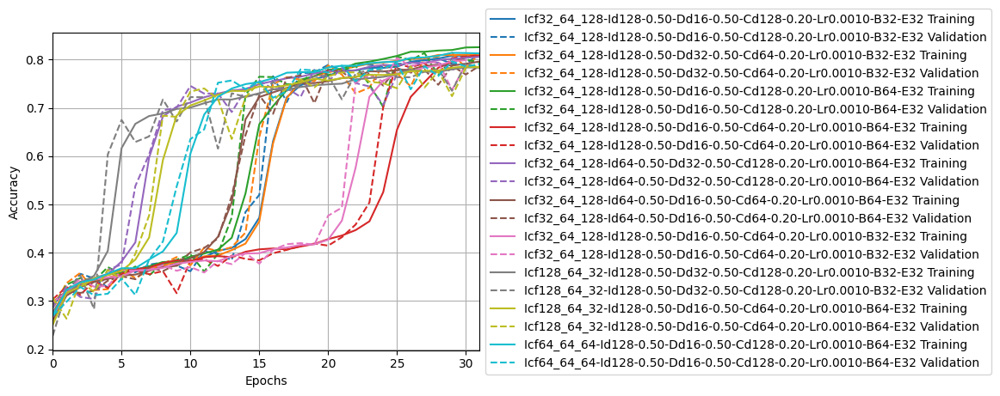

In [41]:
class CandidatePlotter:
    candidate_colors = {}
    def plot_metric(self, candidate_training_histories, metric_name):
        COLORS = plt.rcParams['axes.prop_cycle'].by_key()['color']
        for candidate_name, candidate_history in candidate_training_histories.items():
            if candidate_name in self.candidate_colors:
                color = self.candidate_colors[candidate_name]
            else:
                color = COLORS[len(self.candidate_colors) % len(COLORS)]
                self.candidate_colors[candidate_name] = color            

            training_values = candidate_history.history[metric_name]
            validation_values = candidate_history.history['val_%s' %metric_name]

            plt.plot(candidate_history.epoch, training_values, color = color, label = '%s Training' %candidate_name.title())
            plt.plot(candidate_history.epoch, validation_values, '--', color = color, label = '%s Validation' %candidate_name.title())
    
        plt.xlabel('Epochs')
        plt.ylabel(metric_name.replace('_', ' ').title())
        plt.legend(loc = 'center left', bbox_to_anchor = (1, 0.5))
    
        plt.xlim([0, max([candidate_history.epoch[-1] for candidate_name, candidate_history in candidate_training_histories.items()])])
        plt.grid(True)

top_candidate_plotting_count = 10
print('Candidates test accuracy top list:')
candidate_training_histories = {}
for candidate_idx in range(len(candidates_toplist)):
    candidate = candidates_toplist[candidate_idx]
    print('    %d %s %.6f' %(candidate_idx + 1, candidate.name, candidate.get_results()[1]['accuracy']))
    if top_candidate_plotting_count > len(candidate_training_histories):
        candidate_training_histories[candidate.name] = candidate.get_results()[0]

plotter = CandidatePlotter()
plotter.plot_metric(candidate_training_histories, 'accuracy')

In [42]:
a

NameError: name 'a' is not defined

In [ ]:
str(active_data_profile.tb_log_loc)

In [ ]:
# %tensorboard --logdir /Users/zsalab/Work/UoL/CM3070-FP/data/minsize/tb_log_loc

In [ ]:
#test_ds = load_dataset('test', str(active_data_profile.test_ds_loc), active_data_profile.stored_dataset_compression)

#c = test_ds.cardinality()
#m = 0
#for features, label in test_ds:
#    if random.randint(0, 15) == label.numpy():
#        m += 1
#print('Random Algo Accuracy: %.2f' %(m / c))
#test_ds = None